In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from saxs_data_processing import io, target_comparison, subtract, manipulate

import matplotlib.pyplot as plt
import numpy as np

from apdist import AmplitudePhaseDistance as dist

from scipy.interpolate import UnivariateSpline, CubicSpline, BSpline, make_interp_spline
from scipy.signal import savgol_filter

from scipy import interpolate

In [3]:
## Need to re-run all existing data here


## Load measurement data

In [4]:
bio_conf = 24
root_dirs = ['/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_15_Highlights_replicates/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_11_randomV3_round2/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_07_randomcampaignV3/data/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_17_randomBaselineV4/data/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_05_optimizationRound1/']

In [5]:
data, data_fps, _ = io.load_data_files_biocube(root_dirs, bio_conf)

/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:148: UserWarning: Duplicate UUID found for b8953350-d5ad-4c99-b929-ebfe8febd0df. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:148: UserWarning: Duplicate UUID found for ea0d2ca6-8818-45f8-b5e3-04858133284a. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:148: UserWarning: Duplicate UUID found for 0ec4dd81-7487-4689-96b9-b0f646a2047d. Check your file naming
  warnings.warn(


## Load backgrounds and map to measurement data

In [6]:
# map data to backgrounds
background_fps = ['/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03210_B9-T1_Ethanol_background__000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_07_randomcampaignV3/data/03218_D1-T1_Ethanol_background_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_11_randomV3_round2/03289_H6-T2_EtOH_background_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_15_Highlights_replicates/03357_D5-T2_Background_1_EtOH_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_17_randomBaselineV4/data/03439_C1-T2_EtOH_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_05_optimizationRound1/03533_F9-T1_Ethanol_background_1_000.dat']

# map root filepath to esaxs background
background_mapping = {}

for bcg_fp in background_fps:
    bkg_data = io.read_1D_data(bcg_fp)
    root_dir = '/'.join(bcg_fp.split('/')[:-1])
    background_mapping[root_dir] = bkg_data

In [7]:
uuid2bkg = {}
uuid2root = {}
for uuid_val, fp in data_fps.items():
    root_dir = '/'.join(fp.split('/')[:-1])
    bkg = background_mapping[root_dir]

    uuid2bkg[uuid_val] = bkg

## Subtract and clip measurements

In [20]:
q_min = 0.002
q_max = 0.035

In [32]:
dataset = {}
for uuid_val, signal in data.items():
    background = uuid2bkg[uuid_val]
    subtracted = subtract.chop_subtract(signal[0], background[0], hiq_thresh=1)
    meas_entry = {}
    meas_entry['original_data'] = signal
    meas_entry['background'] = background
    if subtracted is not None:
        subtracted = subtracted[subtracted['q'] < q_max]
        subtracted = subtracted[~subtracted['I'].isna()]
        subtracted = subtracted[subtracted['I'] > 0] # drop negative values 

    if subtracted is not None:
        if len(subtracted) < 10:
            subtracted = None

    if subtracted is not None:
        meas_entry['status'] = 'valid'
    else:
        meas_entry['status'] = 'invalid'

    meas_entry['subtracted_clipped'] = subtracted
    dataset[uuid_val] = meas_entry
    

/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/subtract.py:129: UserWarning: Failed to find region of valid data (low q limit not found). Check that your sample scatters reasonably well
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/subtract.py:197: UserWarning: Issue during data selection, check data quality
  warnings.warn("Issue during data selection, check data quality")
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/subtract.py:134: UserWarning: Insufficient data points in q range with scattering. Check data quality
  warnings.warn(


## Q range normalization

### Find q min and q max for entire dataset


In [10]:
q_mins = []
q_maxs = []
for uuid_val, data_val in dataset.items():
    subtracted = data_val['subtracted_clipped']
    if subtracted is not None:
        q_mins.append(subtracted['q'].min())
        q_maxs.append(subtracted['q'].max())
                  

(array([100.,  11.,   1.,   3.,   0.,   3.,   0.,   1.,   1.,   0.]),
 array([0.   , 0.003, 0.006, 0.009, 0.012, 0.015, 0.018, 0.021, 0.024,
        0.027, 0.03 ]),
 <BarContainer object of 10 artists>)

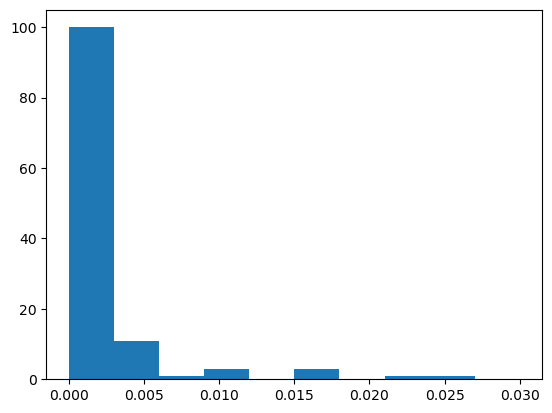

In [11]:
plt.hist(q_mins, range = (0, 0.03))

(array([  3.,   1.,   0.,   5.,   0.,   1.,   0.,   1.,   1., 108.]),
 array([0.02116448, 0.02253978, 0.02391509, 0.0252904 , 0.02666571,
        0.02804102, 0.02941633, 0.03079164, 0.03216695, 0.03354226,
        0.03491756]),
 <BarContainer object of 10 artists>)

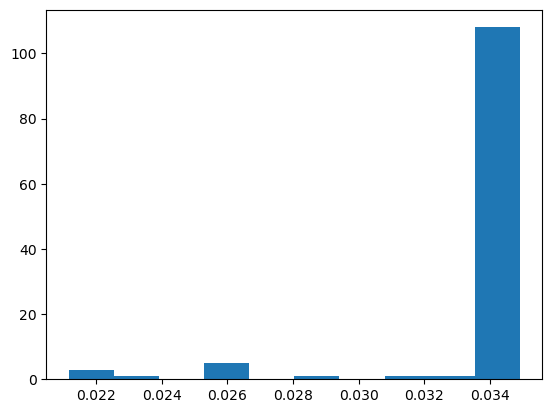

In [12]:
plt.hist(q_maxs)

In [13]:
np.mean(q_mins)

0.0033389443853681896

## Denoise

f4b66637-2c73-4d0b-83ba-3f7e3b3f3c06
True
56898b1b-5aed-4595-ade6-5b73d45a7808
True
f2e85141-9985-49ff-a6bc-17e2ecbcdc8b
7c4bcab3-4ce3-4a28-92b1-4f8a04c76603
True
38d80e08-5bd4-4e0e-9d11-a60d55148590
True
8573b7f6-c239-4d33-aa19-58f59c7d0499
b702c675-432e-4034-b542-ef01ad2fd4ff
True
4b2d55e4-a4ec-419a-aade-a8645321f66a
True
4b56c2d8-0a77-4566-b8fe-51e66454dd75
True
89639692-ddbf-413e-a0c4-bf75456e2877
True
c9f1b338-8d5c-491e-ac9c-cab3df47c1e5
True
ba91b97c-6a58-431f-99ae-091ae1a16bc8
3a3f06cf-6324-44c0-9fbe-cbe35289073b
True
fe183495-7f7b-4949-bc1b-6c7d1ea634b7
True
22fc6d75-43ef-41aa-993b-b76a84f4c5af
True
a6ee3a08-02cd-4703-9d6c-3721dad590c8
True
3b660550-7e2e-4815-ba89-ac39039b2f38
True
f180c1df-360c-45fe-9547-101530b6135a
eb5c038c-56ff-4457-93db-9b9702e3ff43
True
83d8158b-ea97-4925-af7c-8fa89acc9319
True
130093e4-2947-4d37-b73a-ed4c23442ab8
True
6411e428-3416-4aad-a246-f50fe8f3fb4b
True
86a7ac96-49f1-4da4-b518-37e4ab31a099
e34d9838-8677-405f-b825-5068facac35e
True
852b1fcf-ea63-443

/tmp/ipykernel_81717/446668414.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


48117328-d486-4f9f-96ab-b0034fe30cd5
True
c2755e87-75e2-48c6-b27a-739971d1775c
True
fedab157-3d87-4f8b-b09b-590c966aa0ba
True
f59733f7-c03c-4712-934e-fb6ea464b604
True
ecc20fb9-daca-4f65-97ce-f1329696f7ec
True
3ae01d8c-6757-4aa4-8701-a4f231f6a81c
True
48c60f84-a45b-4017-9430-12b3234fdc0e
True
2a0a2e87-67a7-401a-943d-423159a4a939
True
43cd6089-f940-463f-bd40-a1f2bf168f67
True
9b9c349b-8f9d-4f0c-829c-fa99e67e90fb
True
ff3ac045-3c39-4fb0-b2c9-bf69d7600548
5452fa4a-b64c-46d7-ace2-bf1b31afc3b3
9aed2e5c-7127-46bd-8331-51407d127d8f
True
5edc0763-1f2c-44f2-bf68-db785ae258b0
True
320cdd85-691d-48fb-9eac-d27b2fc5e5f5
True
bf04b495-3291-4508-a497-e6d96dc52362
True
649ddf37-37fe-4a30-896b-010286133a28
5175dc78-a900-486e-8b14-6b0441555fe2
True
2a988138-57f5-40bf-851c-3df09f642f05
True
9694a191-11f7-482c-bb4c-e119489126a4
True
a9d67fc5-2e59-4f51-a904-9cac957c9e73
True
2027f32f-4921-4edd-95bb-849ab8220e8c
True
f5458994-6b3e-4176-9427-7cef2bb6c7d5
True
5d67ff81-9548-4a2f-9496-5d3c3c25b3eb
True
81f8f6c

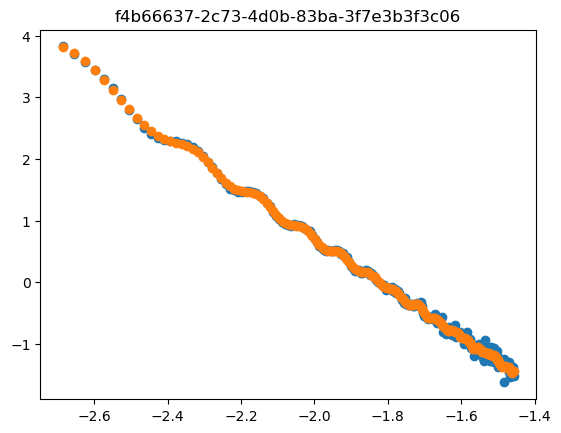

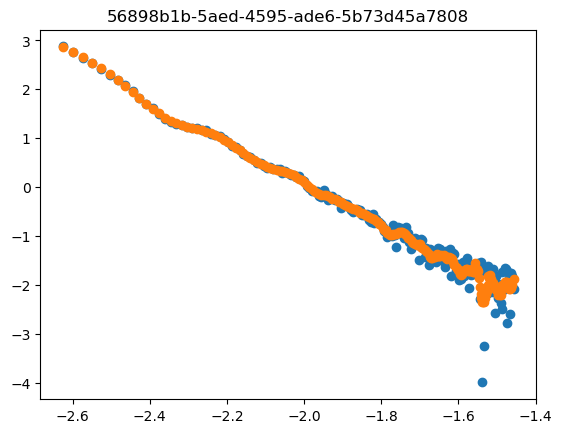

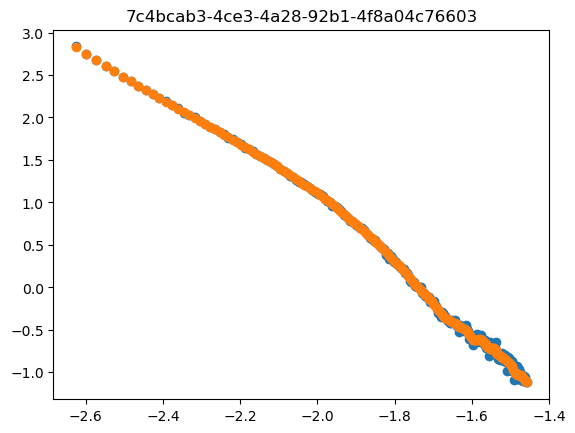

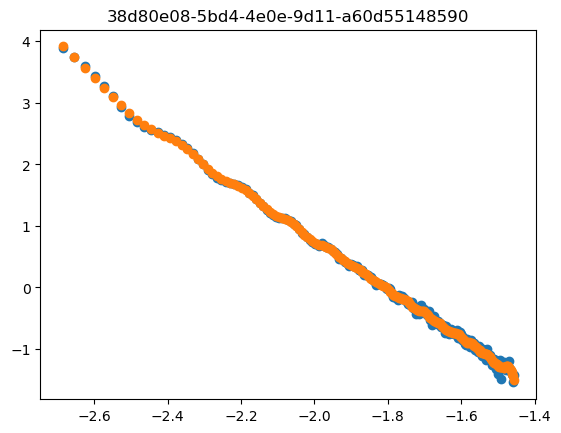

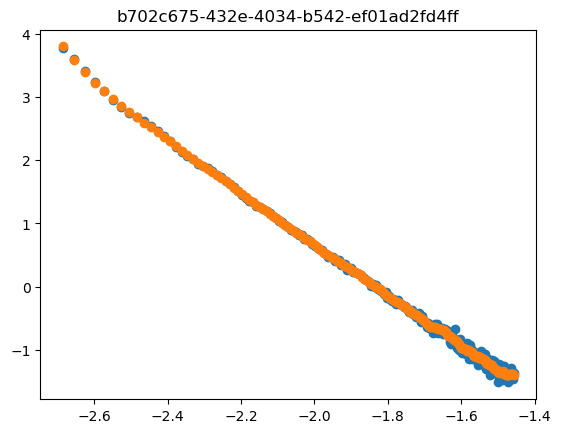

...

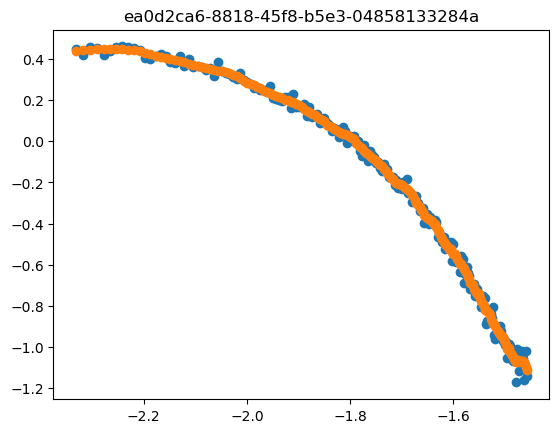

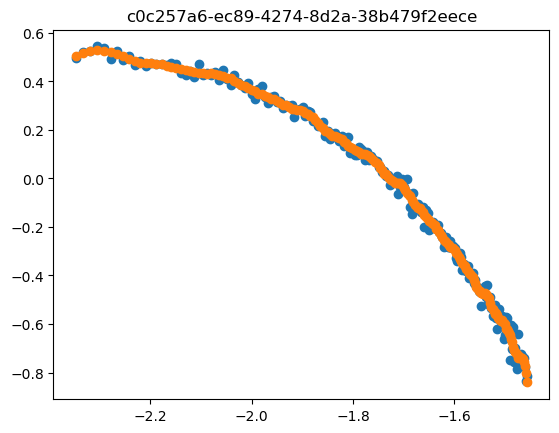

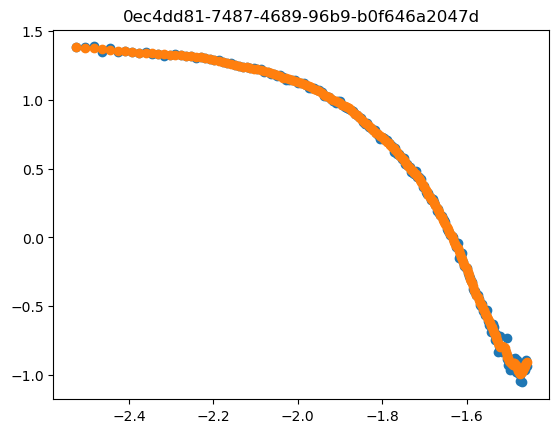

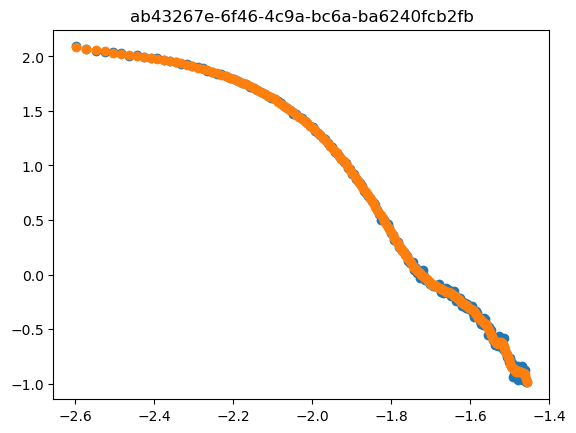

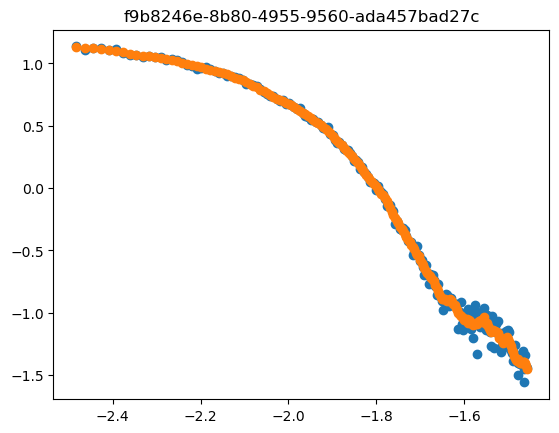

In [34]:
savgol_n = 15
savgol_order = 3
min_data_len = 100


for uuid_val, entry in dataset.items():
    subtracted = entry['subtracted_clipped']
    print(uuid_val)
    if entry['status'] == 'valid':
        if len(subtracted) > min_data_len:
            q_log = np.log10(entry['subtracted_clipped']['q'].to_numpy())
            I_log = np.log10(entry['subtracted_clipped']['I'].to_numpy())
    
            print(np.isfinite(I_log).all())
    
            I_savgol = savgol_filter(I_log, savgol_n, savgol_order)
    
            dataset[uuid_val]['I_savgol'] = I_savgol
            dataset[uuid_val]['q_log_original'] = q_log
            dataset[uuid_val]['I_log_subtracted'] = I_log
    
            fig, ax = plt.subplots()
    
            ax.scatter(q_log, I_log, label = 'original')
            ax.scatter(q_log, I_savgol, label = 'denoise')
            ax.set_title(uuid_val)
        else:
            dataset[uuid_val]['status'] = 'invalid'

In [18]:
dataset['ff3ac045-3c39-4fb0-b2c9-bf69d7600548']['subtracted_clipped']

,q,I,sig
46,0.007106,0.526117,0.063254
47,0.007259,0.572833,0.066633
48,0.007411,0.319839,0.048808
49,0.007564,0.383229,0.054215
50,0.007717,0.379251,0.050424
...,...,...,...
140,0.021470,0.007286,0.005706
141,0.021623,0.006192,0.006743
142,0.021776,0.004113,0.005774
146,0.022387,0.006081,0.005947


## Interpolate measured data with a spline

In [27]:
q_min_spl = 0.003
q_max_spl = 0.03
q_grid = np.linspace(np.log10(q_min_spl), np.log10(q_max_spl), 1001)
#q_grid = np.linspace(np.log10(q_min), np.log10(q_max), 501)

f4b66637-2c73-4d0b-83ba-3f7e3b3f3c06
56898b1b-5aed-4595-ade6-5b73d45a7808
f2e85141-9985-49ff-a6bc-17e2ecbcdc8b
7c4bcab3-4ce3-4a28-92b1-4f8a04c76603
38d80e08-5bd4-4e0e-9d11-a60d55148590
8573b7f6-c239-4d33-aa19-58f59c7d0499
b702c675-432e-4034-b542-ef01ad2fd4ff
4b2d55e4-a4ec-419a-aade-a8645321f66a
4b56c2d8-0a77-4566-b8fe-51e66454dd75
89639692-ddbf-413e-a0c4-bf75456e2877
c9f1b338-8d5c-491e-ac9c-cab3df47c1e5
ba91b97c-6a58-431f-99ae-091ae1a16bc8
3a3f06cf-6324-44c0-9fbe-cbe35289073b
fe183495-7f7b-4949-bc1b-6c7d1ea634b7
22fc6d75-43ef-41aa-993b-b76a84f4c5af
a6ee3a08-02cd-4703-9d6c-3721dad590c8
3b660550-7e2e-4815-ba89-ac39039b2f38
f180c1df-360c-45fe-9547-101530b6135a
eb5c038c-56ff-4457-93db-9b9702e3ff43
83d8158b-ea97-4925-af7c-8fa89acc9319
130093e4-2947-4d37-b73a-ed4c23442ab8
6411e428-3416-4aad-a246-f50fe8f3fb4b
86a7ac96-49f1-4da4-b518-37e4ab31a099
e34d9838-8677-405f-b825-5068facac35e
852b1fcf-ea63-4436-bd20-9ebf44baf999
a3f7d49b-cc77-4468-aae0-ad451027ddc0
8f7962c4-620f-42e2-812b-2b161525c034
7

/tmp/ipykernel_81717/3673735437.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize = (15,12))


f59733f7-c03c-4712-934e-fb6ea464b604
ecc20fb9-daca-4f65-97ce-f1329696f7ec
3ae01d8c-6757-4aa4-8701-a4f231f6a81c
48c60f84-a45b-4017-9430-12b3234fdc0e
2a0a2e87-67a7-401a-943d-423159a4a939
43cd6089-f940-463f-bd40-a1f2bf168f67
9b9c349b-8f9d-4f0c-829c-fa99e67e90fb
ff3ac045-3c39-4fb0-b2c9-bf69d7600548
5452fa4a-b64c-46d7-ace2-bf1b31afc3b3
9aed2e5c-7127-46bd-8331-51407d127d8f
5edc0763-1f2c-44f2-bf68-db785ae258b0
320cdd85-691d-48fb-9eac-d27b2fc5e5f5
bf04b495-3291-4508-a497-e6d96dc52362
649ddf37-37fe-4a30-896b-010286133a28
5175dc78-a900-486e-8b14-6b0441555fe2
2a988138-57f5-40bf-851c-3df09f642f05
9694a191-11f7-482c-bb4c-e119489126a4
a9d67fc5-2e59-4f51-a904-9cac957c9e73
2027f32f-4921-4edd-95bb-849ab8220e8c
f5458994-6b3e-4176-9427-7cef2bb6c7d5
5d67ff81-9548-4a2f-9496-5d3c3c25b3eb
81f8f6c2-0e42-4680-bc11-c0be02bfd641
47d95862-b511-4a42-b8b1-961b605f26a3
6abcfcc8-cf8d-4a5e-a92f-f3afd8023fbd
89b8593e-8436-4dfb-8430-1367d273cbc2
8559907a-1b27-4673-ae0e-602b83d86deb
fe8e4a28-cb6b-4396-adc3-a51f49838d54
b

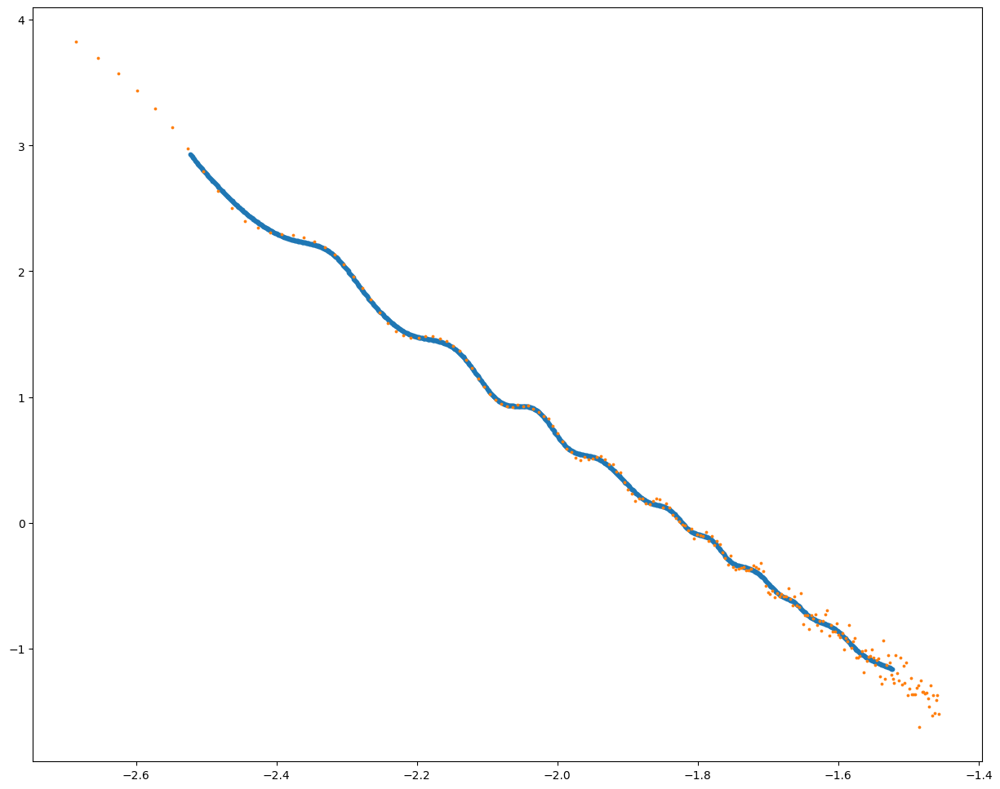

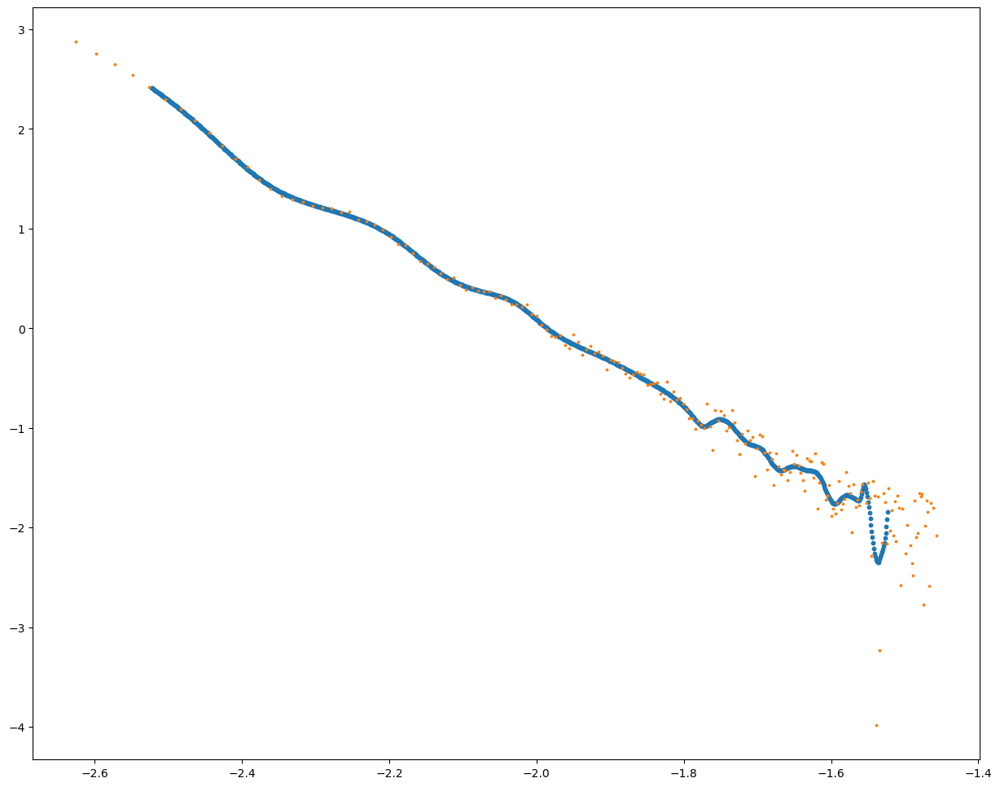

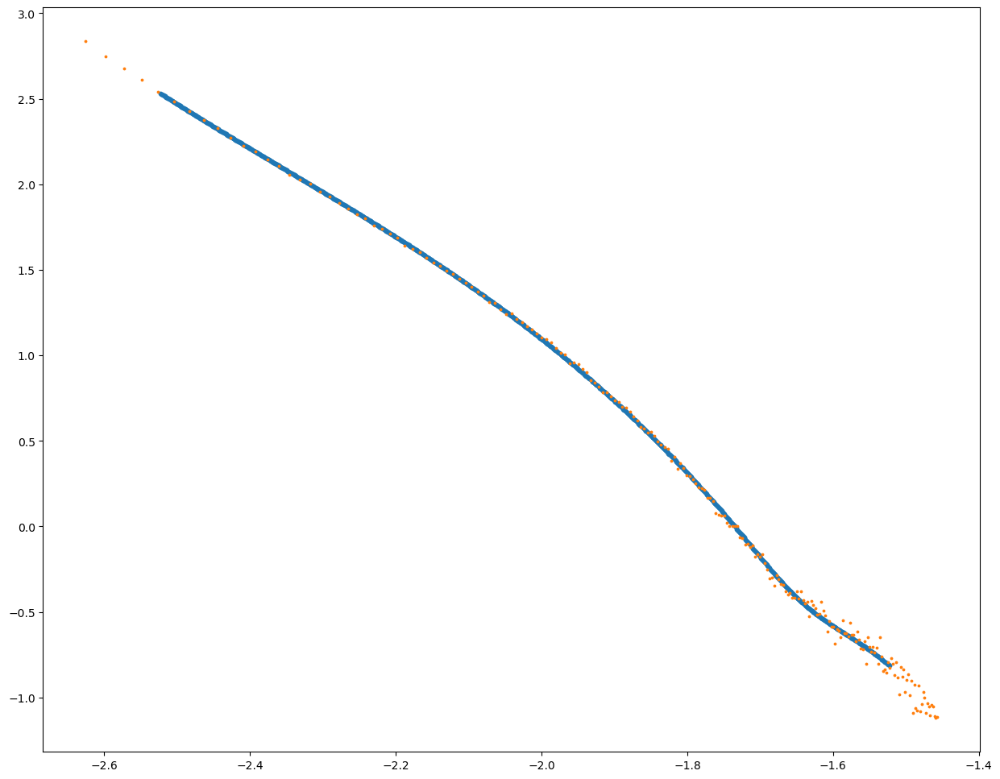

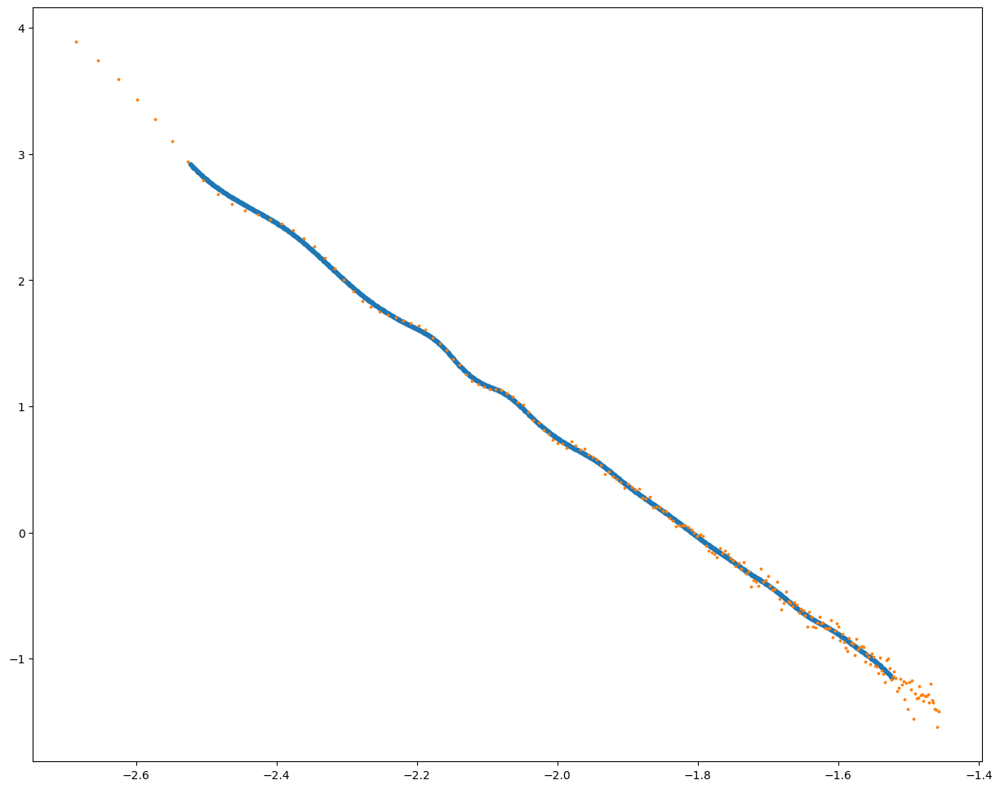

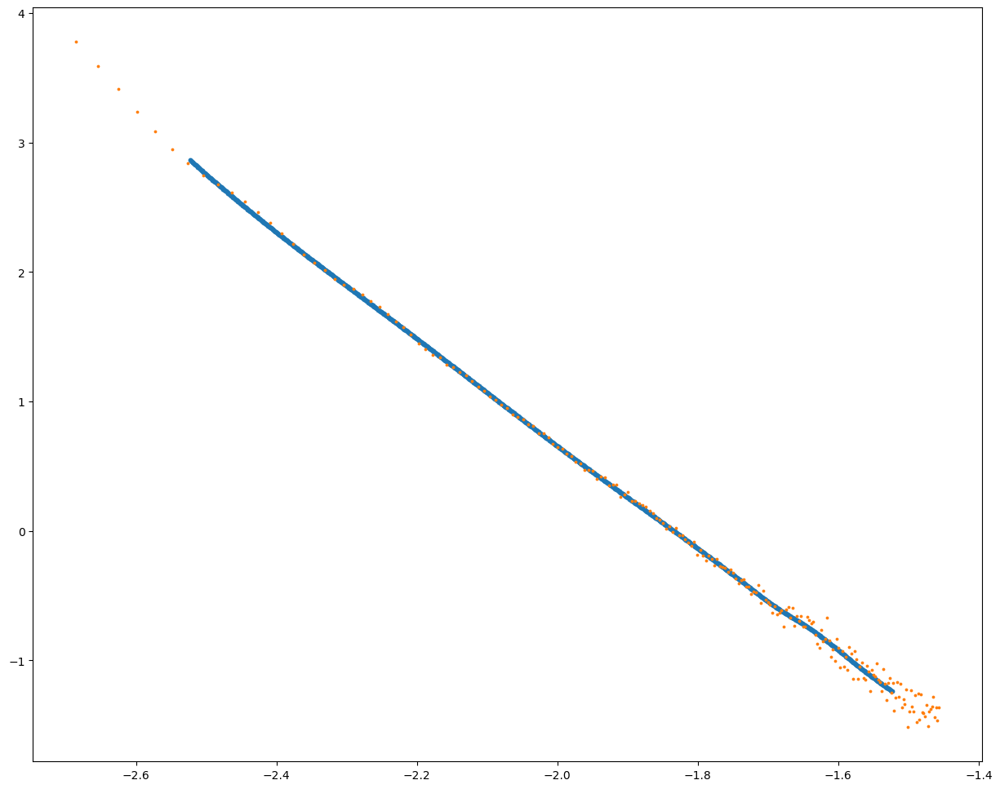

...

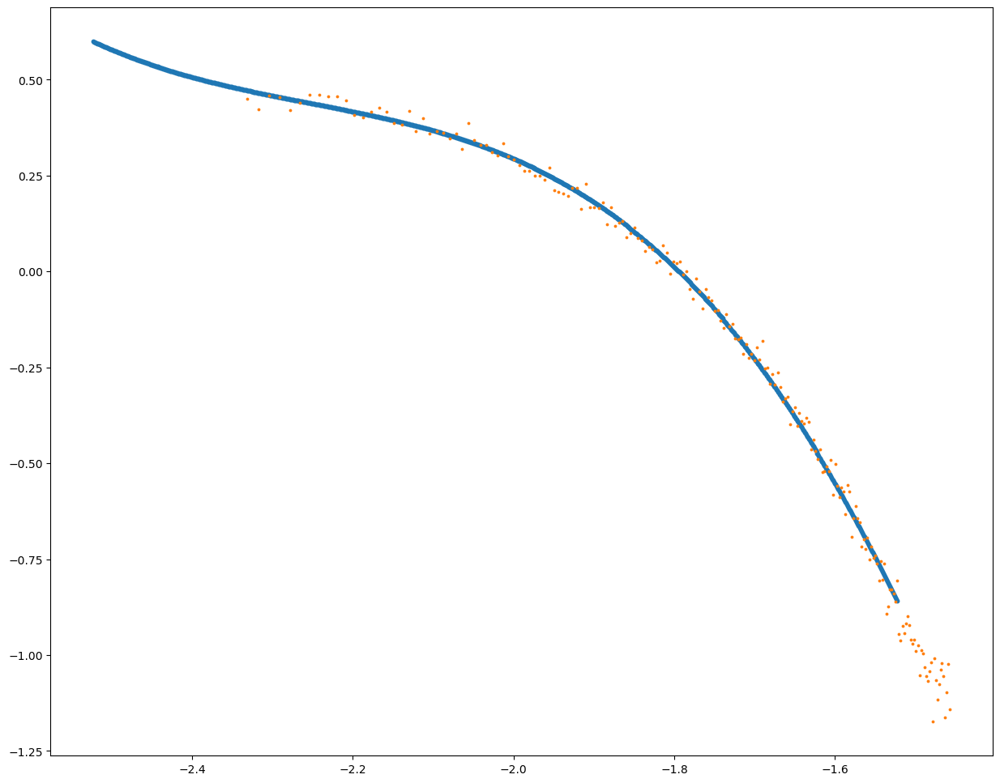

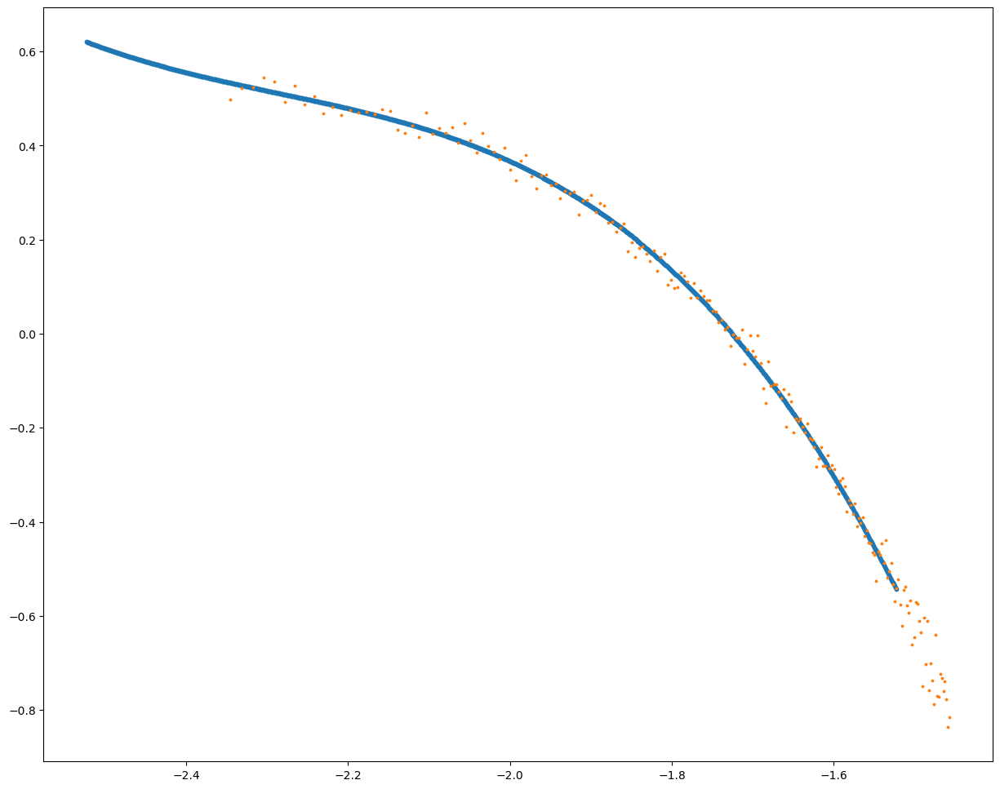

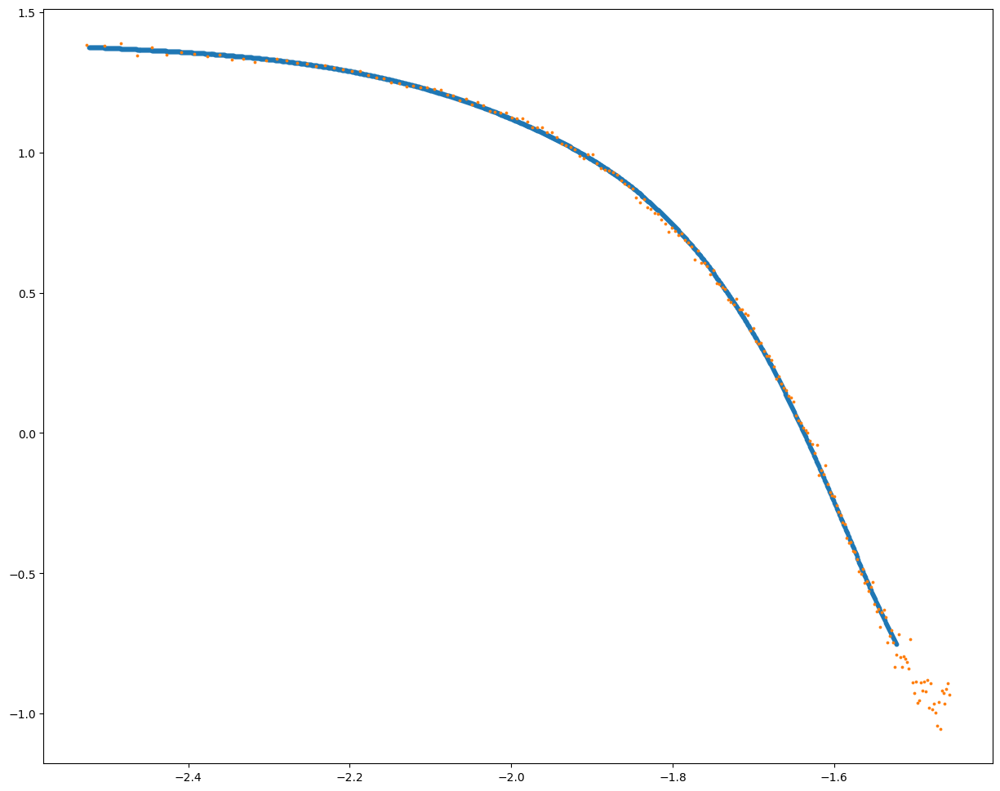

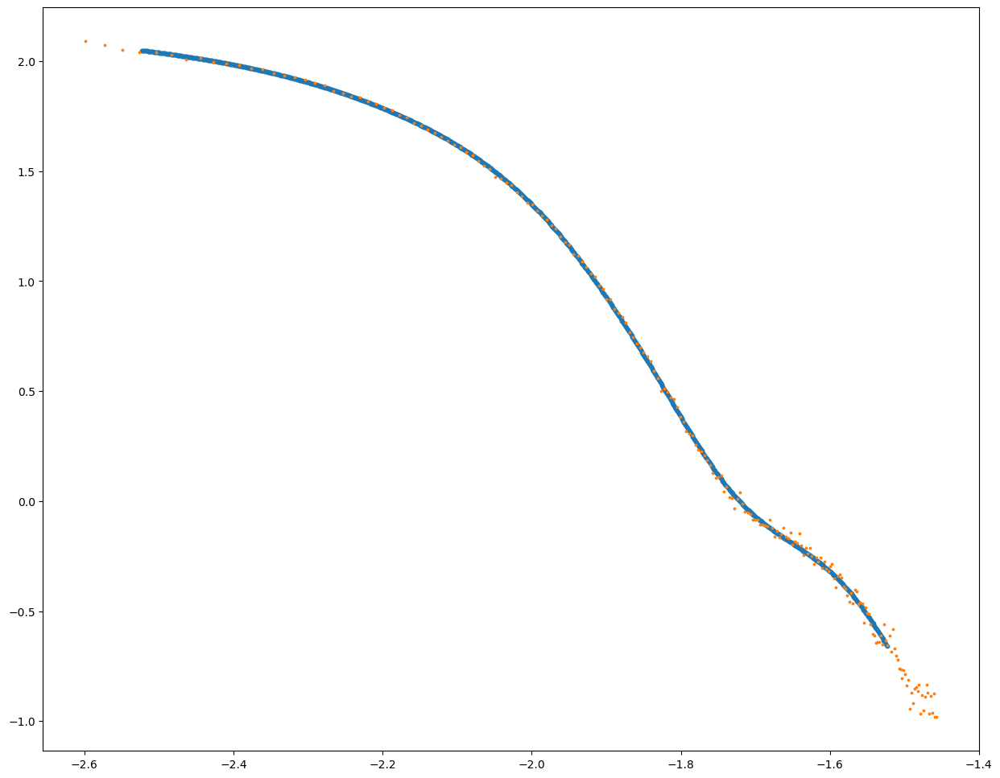

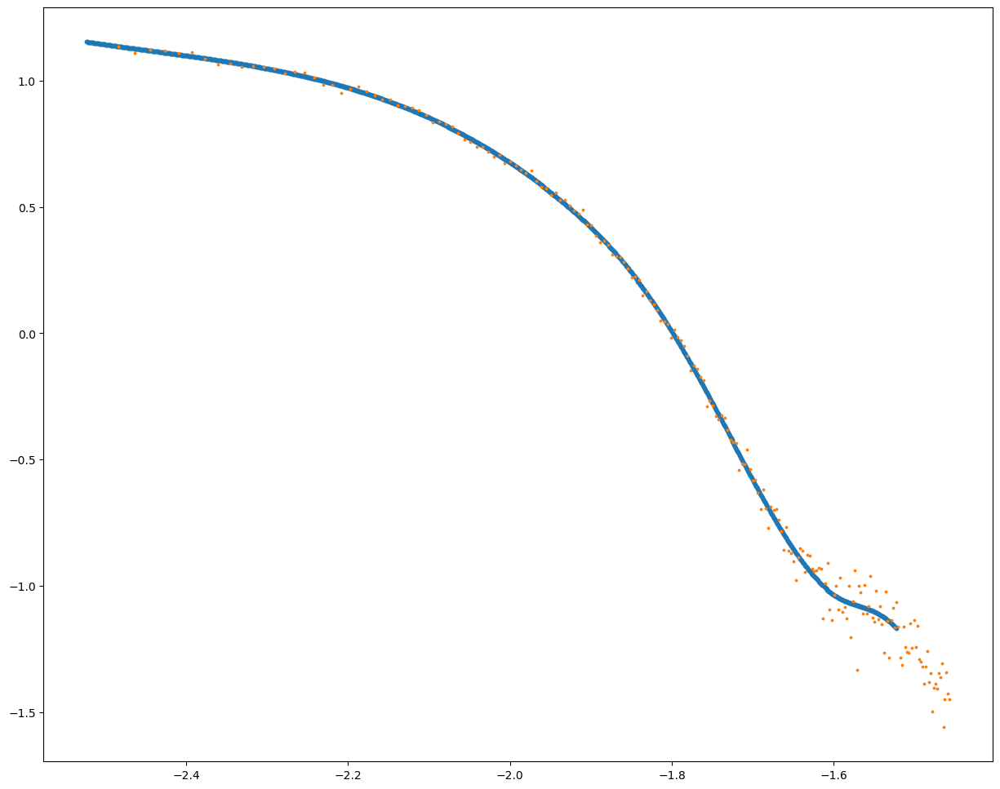

In [35]:
s = 0.05

for uuid_val, entry in dataset.items():
    print(uuid_val)
    if entry['status'] == 'valid':
        try:
            q = entry['q_log_original']
            I_savgol = entry['I_savgol']
        
            spl = BSpline(*interpolate.splrep(q, I_savgol, s = s, k = 3))
            #spl = make_interp_spline(q, I_savgol, k = 3, bc_type = ('natural', 'natural'))
            #spl = interpolate.CubicSpline(q, I_savgol, bc_type='natural')
            I_spl = spl(q_grid)
            dataset[uuid_val]['q_grid'] = q_grid
            dataset[uuid_val]['I_spline'] = I_spl
        
            fig, ax = plt.subplots(figsize = (15,12))
            ax.scatter(q_grid, I_spl, s=10, label = 'spline')
            ax.scatter(q, entry['I_log_subtracted'], s = 3, label = 'data')
        except KeyError:
            continue



## Scale based on high q values

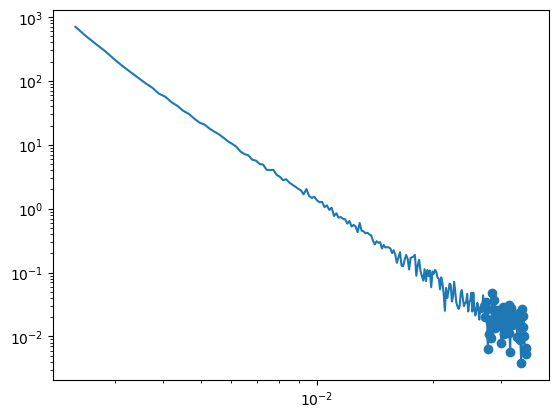

In [38]:
test_data = dataset['3b660550-7e2e-4815-ba89-ac39039b2f38']['subtracted_clipped']

n = 50
plt.loglog(test_data['q'], test_data['I'])
plt.scatter(test_data['q'].iloc[-n:], test_data['I'].iloc[-n:])

## calculate scattering distance metric

In [30]:
target_r_nm = 60
target_r_angs = target_r_nm*10
target_pdi = 0.08

sld_silica = 8.575
sld_etoh = 9.611

In [45]:
q_grid_nonlog = 10**q_grid

In [136]:
target_I = target_comparison.target_intensities(q_grid_nonlog, target_r_angs, target_pdi, sld_silica, sld_etoh)
target_I = np.log10(target_I)
#target_I = (target_I - target_I.min())/(target_I.max() - target_I.min()) # normalize to 1

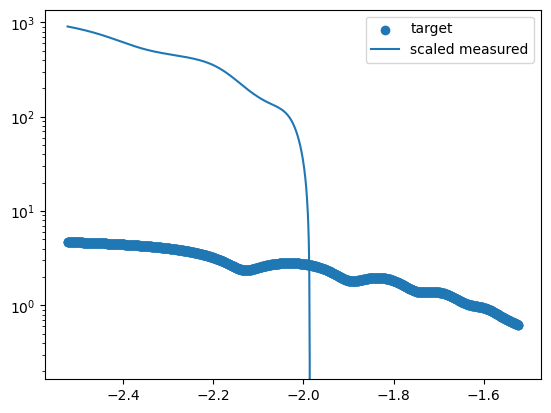

In [134]:
I_spl = dataset['56898b1b-5aed-4595-ade6-5b73d45a7808']['I_spline']
n_avg = 200


I_spl_pow = I_spl

#plt.scatter(q_grid, I_spl_pow)
plt.scatter(q_grid, target_I, label = 'target')
#plt.scatter(q_grid[-n_avg:], target_I[-n_avg:])
#plt.scatter(q_grid[-n_avg:], I_spl[-n_avg:])


avg_target = 10**np.mean(target_I[-n_avg:])
avg_spline = 10**np.mean(I_spl_pow[-n_avg:])


quotient = np.abs(avg_spline)/avg_target

plt.semilogy(q_grid, I_spl_pow*(1/quotient), label = 'scaled measured')

plt.legend()



In [135]:
def scale_intensity(measured_I, target_I, n_avg):
    # 1. convert both back into I space from logI space
    pow_meas = 10**measured_I
    pow_target = 10**target_I
    # 2. get quotient
    avg_target = np.mean(pow_target[-n_avg:])
    avg_meas = np.mean(pow_meas[-n_avg:])
    quotient = np.abs(avg_target/avg_meas)
    # 3. scale measured
    scaled_meas = pow_meas*quotient
    # convert back to log space
    scaled_meas = np.log10(scaled_meas)
    return scaled_meas
    

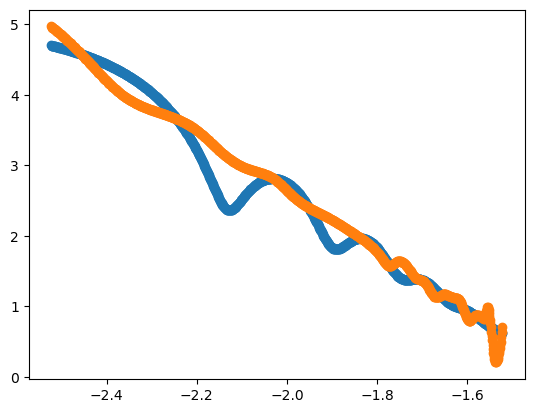

In [139]:
I_spl = dataset['56898b1b-5aed-4595-ade6-5b73d45a7808']['I_spline']


scaled_I = scale_intensity(I_spl, target_I, 200)

plt.scatter(q_grid, target_I)
plt.scatter(q_grid, scaled_I)

In [125]:
quotient

0.0027808878307744238

In [126]:
avg_spline

0.0339548786428943

In [127]:
avg_target

12.210085666575958

In [128]:
target_I

array([5.01583534e+04, 4.99802430e+04, 4.98018594e+04, ...,
       4.22033055e+00, 4.18764831e+00, 4.15484939e+00])

/tmp/ipykernel_81717/4187851939.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize = (15,12))
/tmp/ipykernel_81717/3021527402.py:12: RuntimeWarning: divide by zero encountered in log10
  scaled_meas = np.log10(scaled_meas)


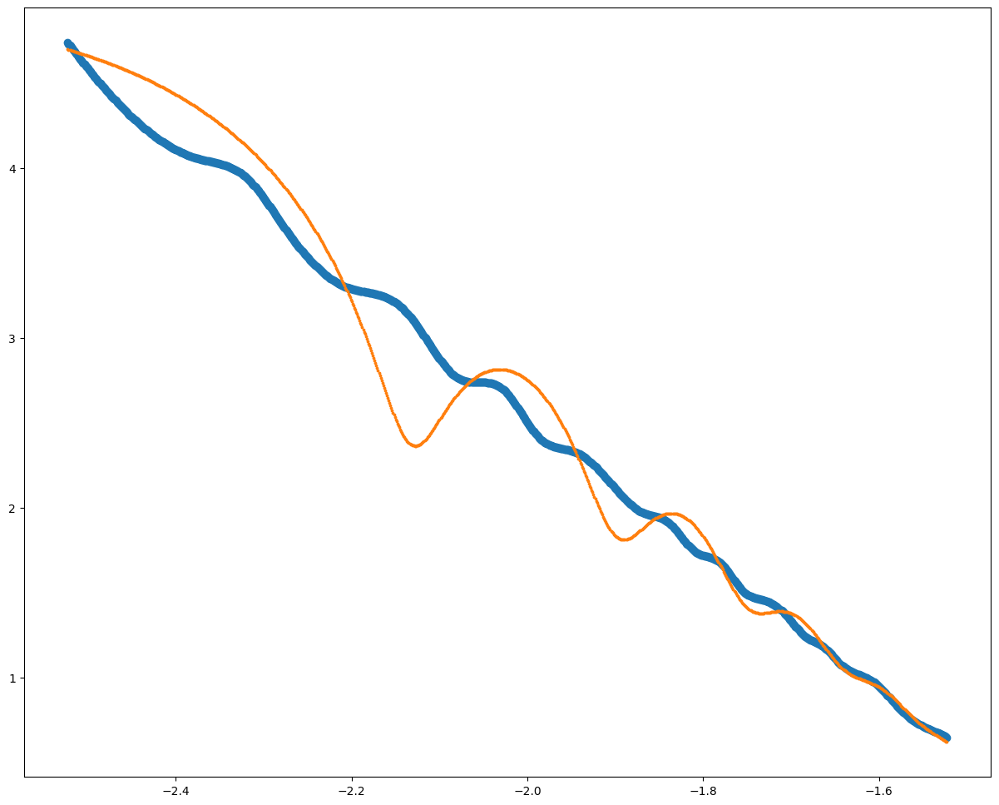

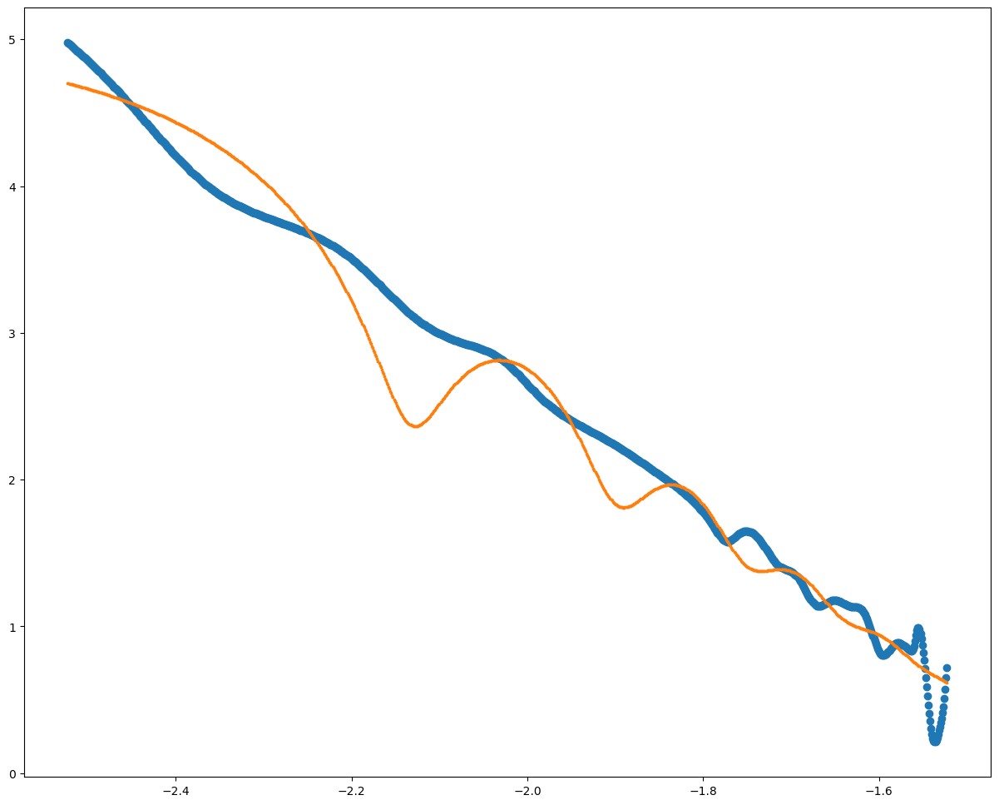

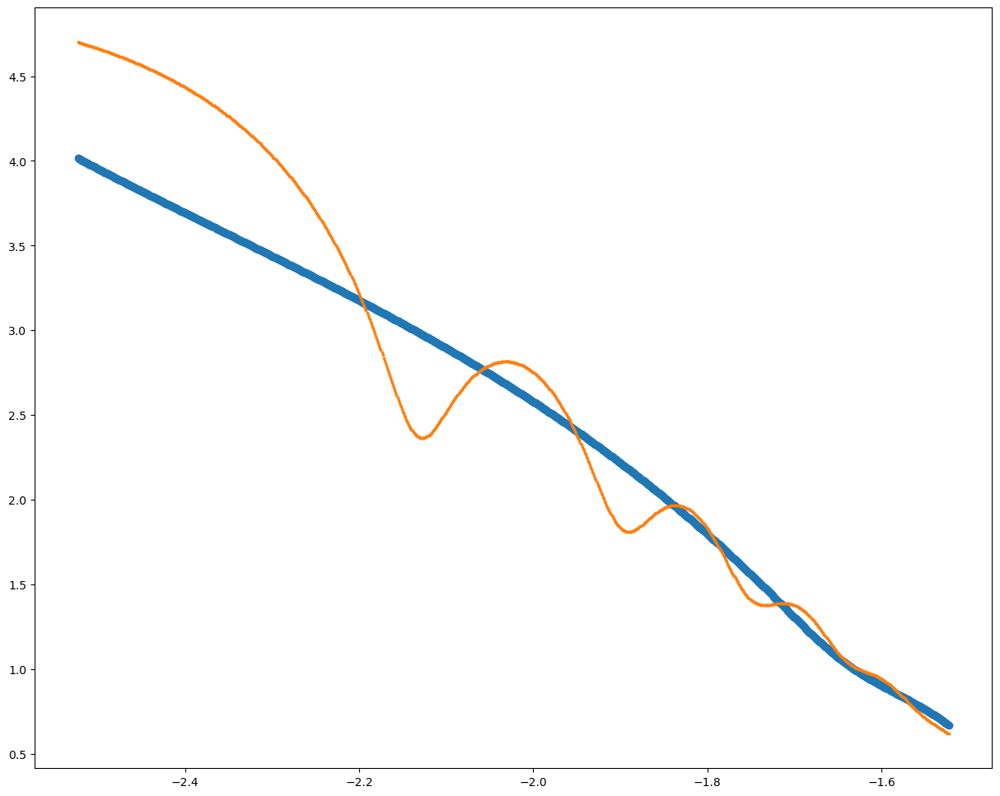

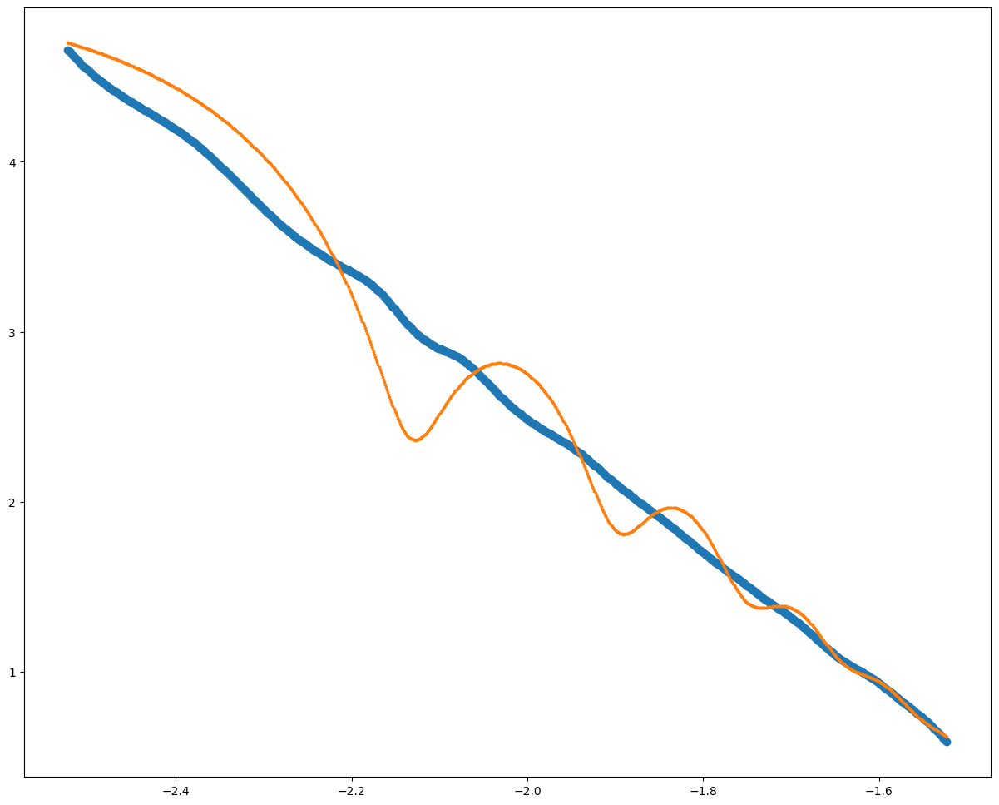

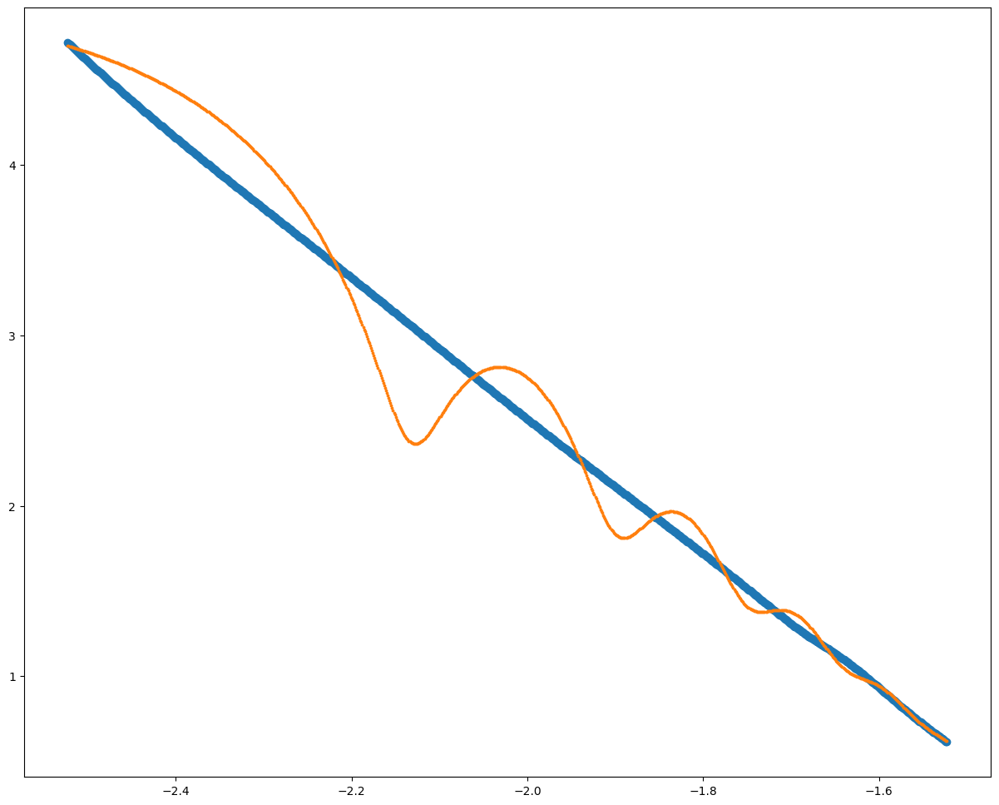

...

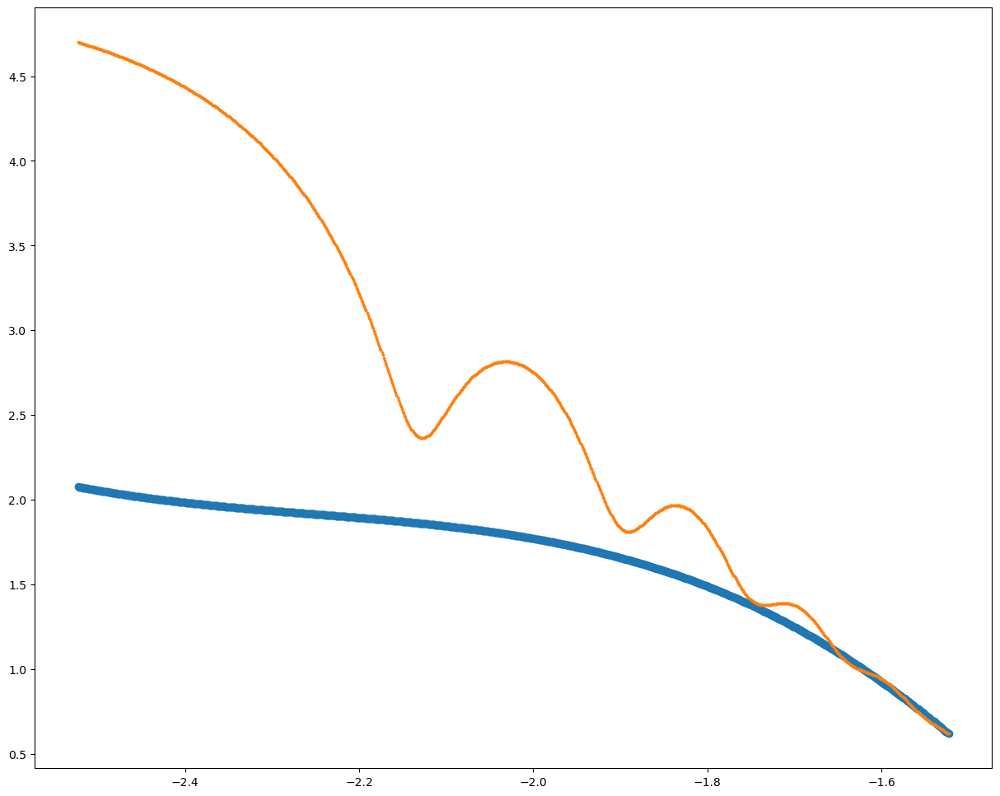

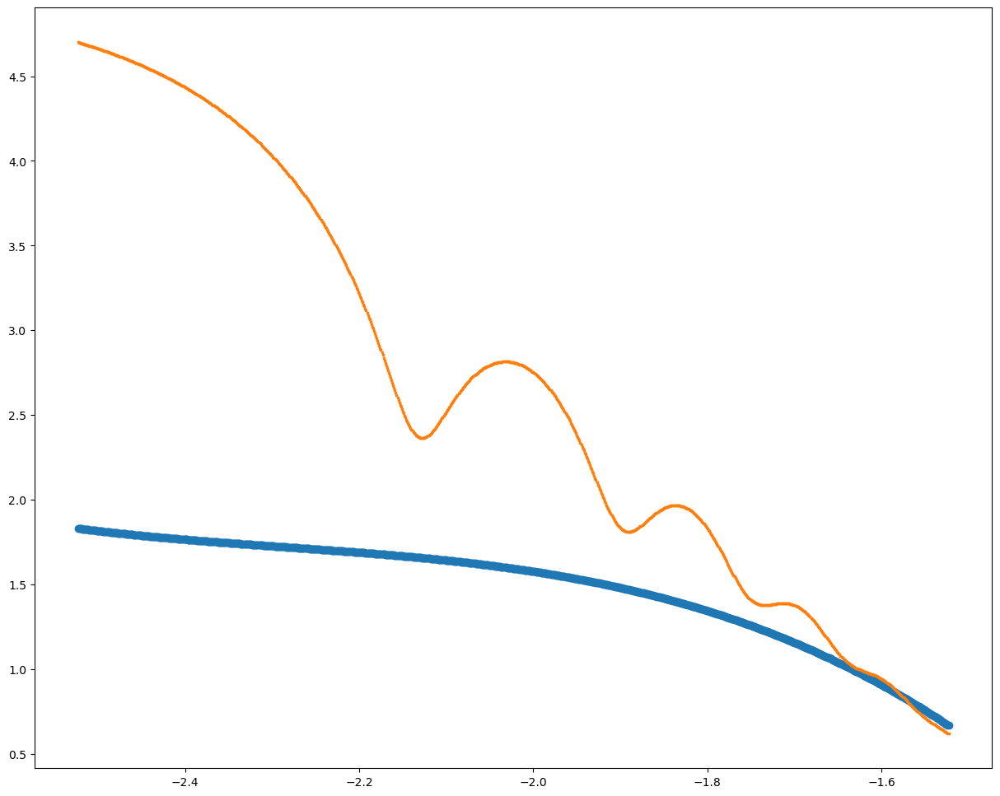

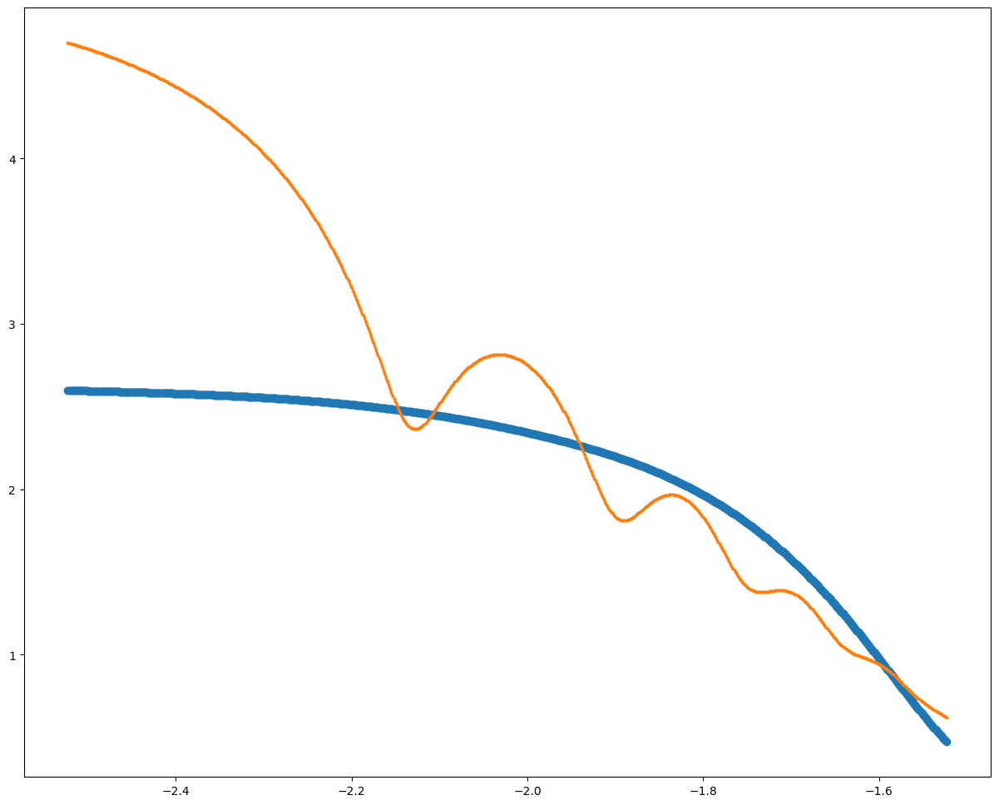

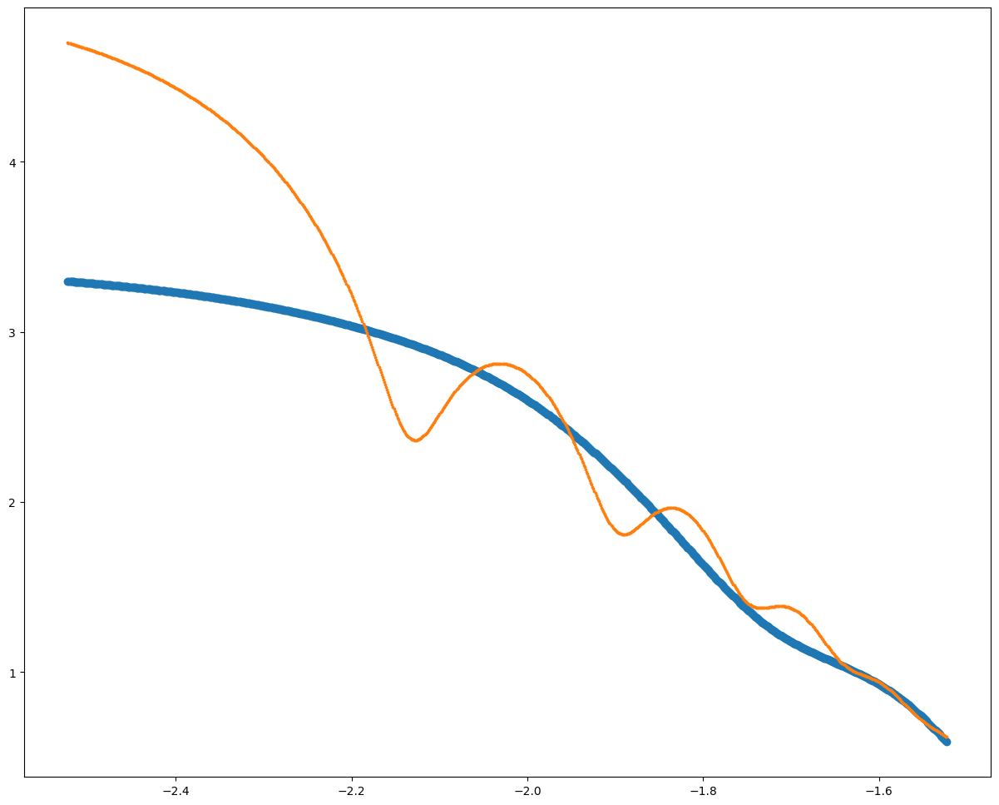

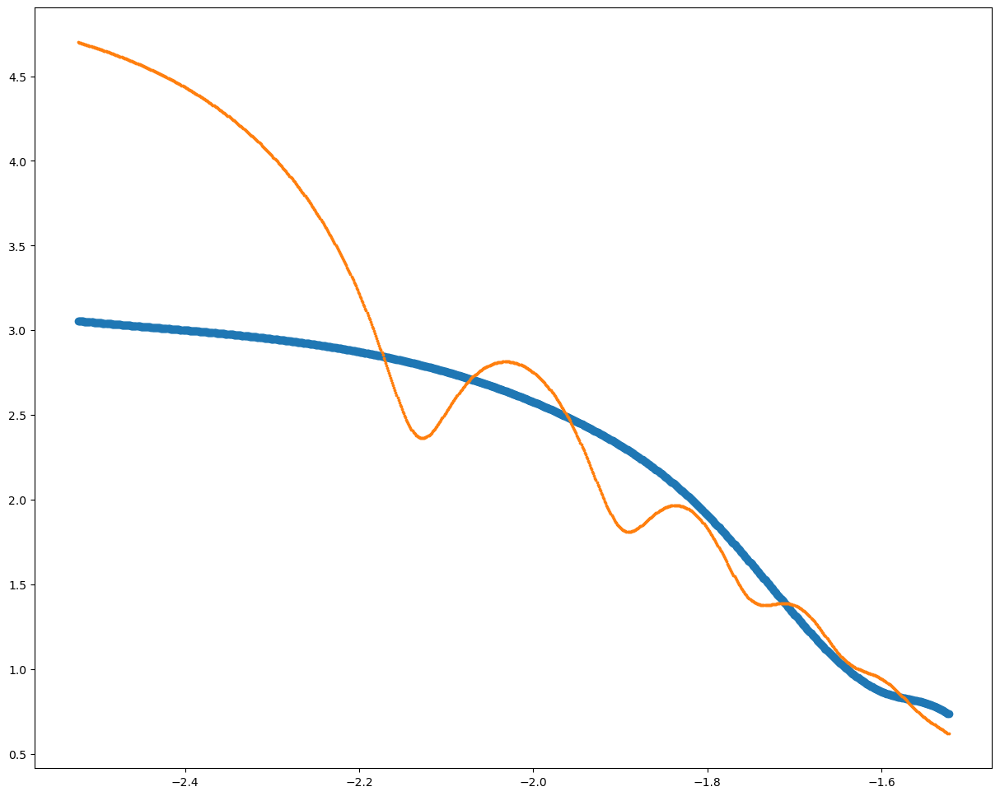

In [140]:
n_avg = 100

for uuid_val, entry in dataset.items():
    if entry['status'] == 'valid':

        meas_I = entry['I_spline']
        I_scale = scale_intensity(meas_I, target_I, n_avg)

        dataset[uuid_val]['I_scaled'] = I_scale

        fig, ax = plt.subplots(figsize = (15,12))
        ax.scatter(q_grid, I_scale)
        ax.scatter(q_grid, target_I, s = 3, label = 'target')

In [31]:
optim_kwargs = {"optim":"DP", "grid_dim":10}

In [141]:
amp_dist = {}
phase_dist = {}

for uuid_val, data_val in dataset.items():

    if data_val['status'] == 'valid':
        I_scaled = data_val['I_scaled']
        
    
        try:
            amp, phase = dist(q_grid, I_scaled, target_I, **optim_kwargs)
        
            amp_dist[uuid_val] = amp
            phase_dist[uuid_val] = phase
    
        except:
            print(f'Error on {uuid_val}')
    


        

## Plot sorted results - amplitude

In [142]:
uuids = np.array(list(amp_dist.keys()))
rmses = list(amp_dist.values())
uuid_sorted = uuids[np.argsort(rmses)]

/tmp/ipykernel_81717/2791214942.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


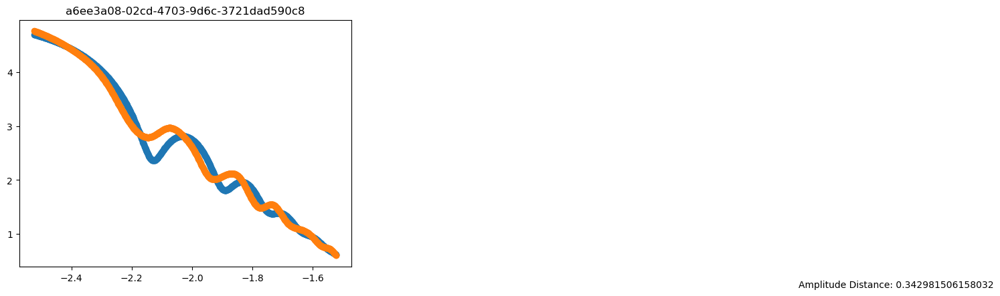

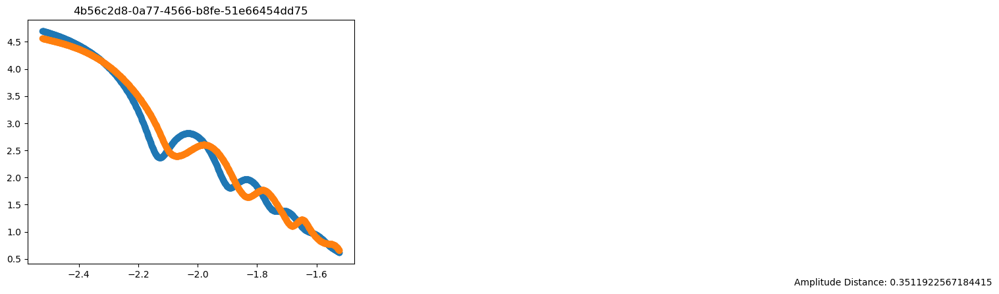

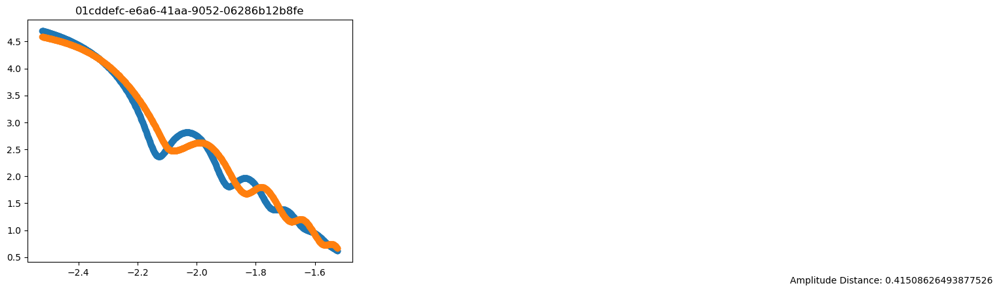

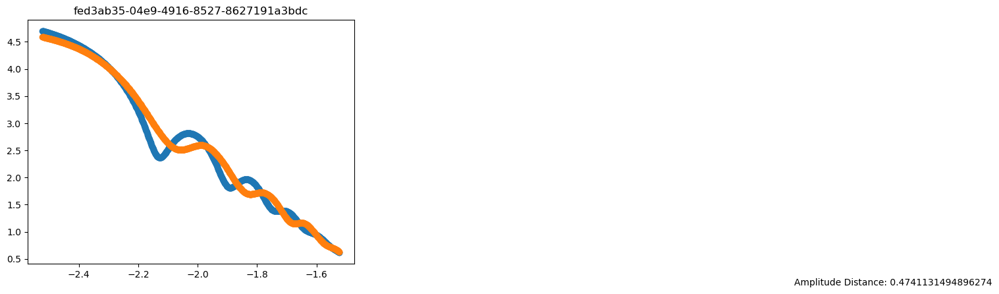

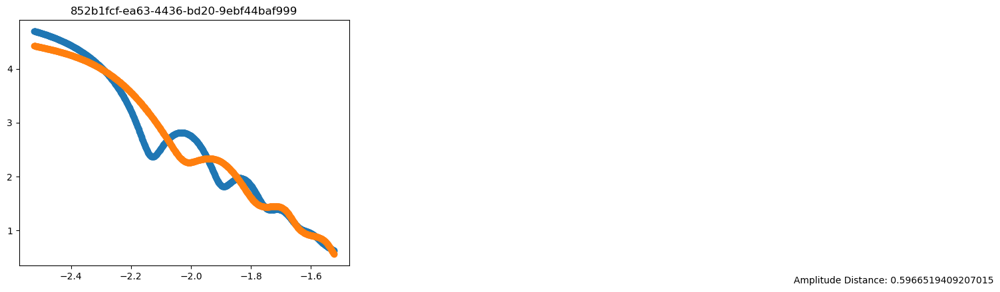

...

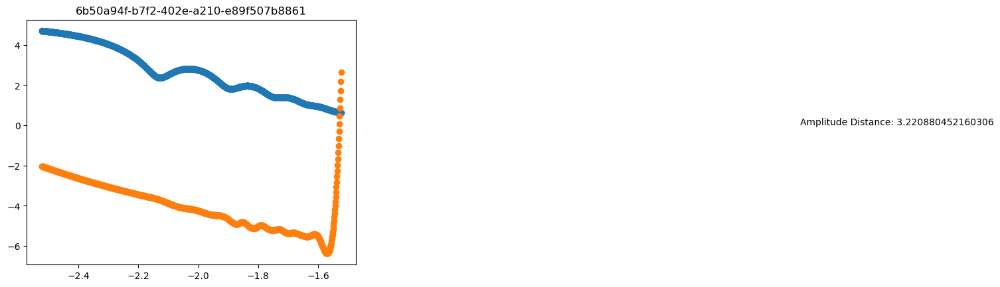

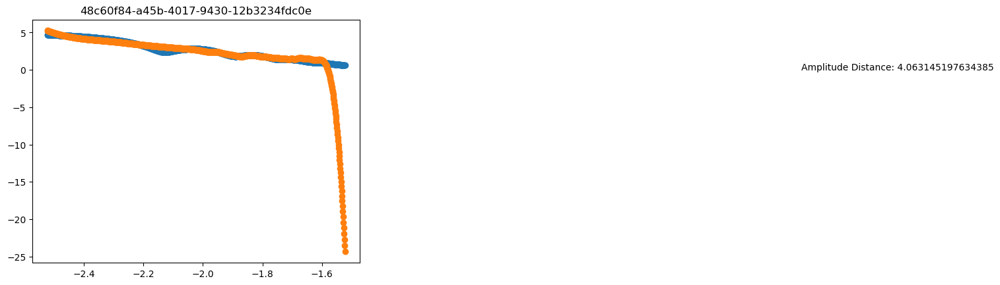

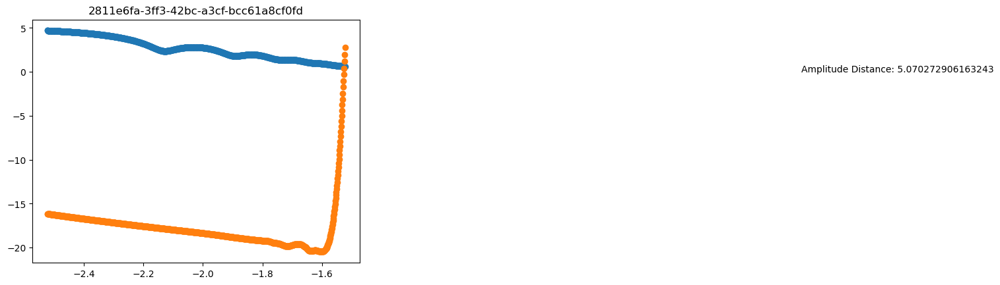

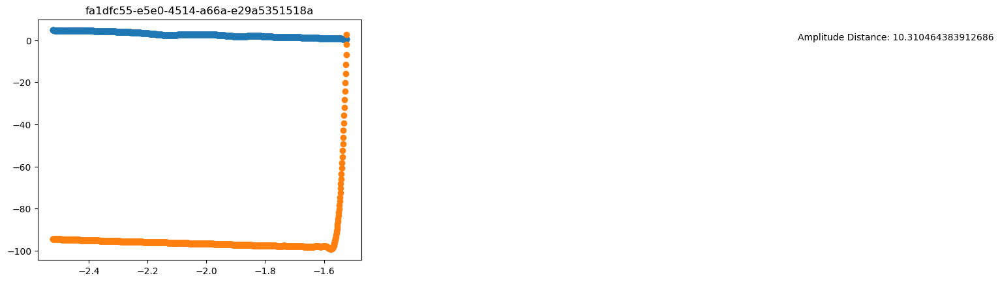

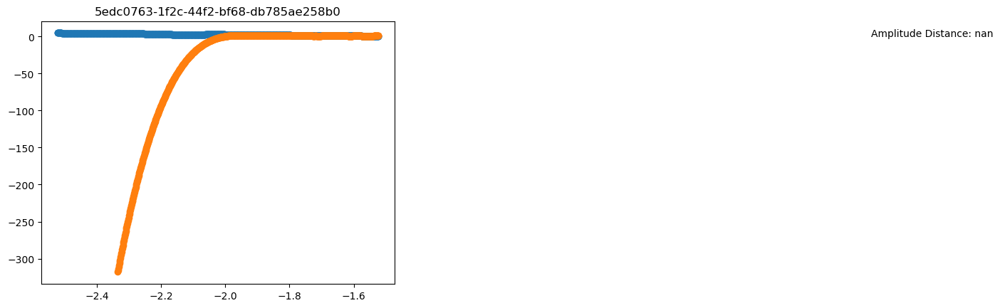

In [147]:
for uuid_val in uuid_sorted:
    #try:
    entry  = dataset[uuid_val]
    data_val = entry['I_scaled']
    
    #except KeyError:
    #    print(uuid_val)
    #    continue
    if entry['status'] == 'valid':


        distance = amp_dist[uuid_val]

        fig, ax = plt.subplots()
        ax.scatter(q_grid, target_I)
        ax.scatter(q_grid, data_val)
        ax.set_title(uuid_val)
        ax.text(0.01, 0.01, f'Amplitude Distance: {distance}')

## Plot sorted results - phase distance

In [148]:
uuids = np.array(list(phase_dist.keys()))
rmses = list(phase_dist.values())
uuid_sorted_phase = uuids[np.argsort(rmses)]

/tmp/ipykernel_81717/430369953.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


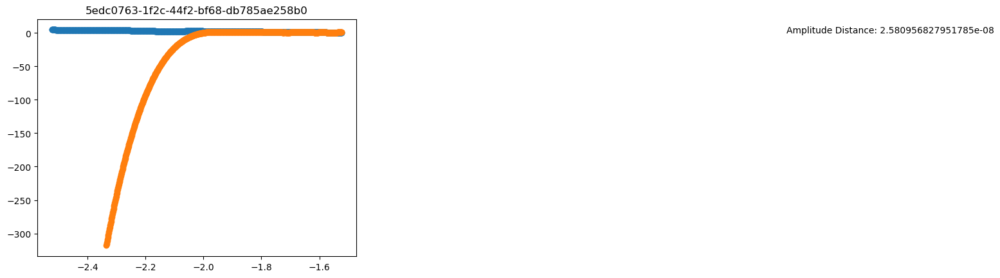

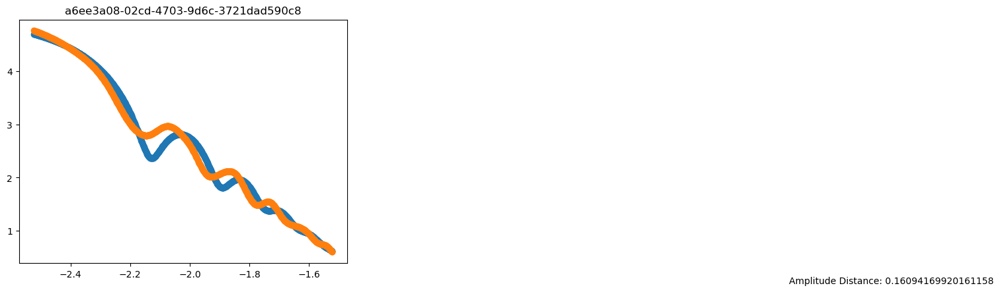

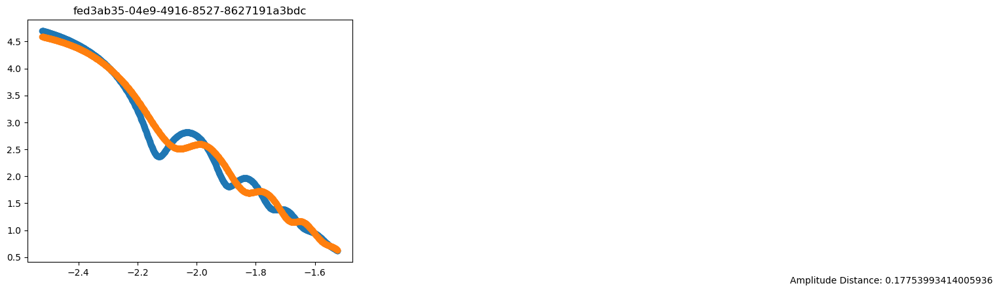

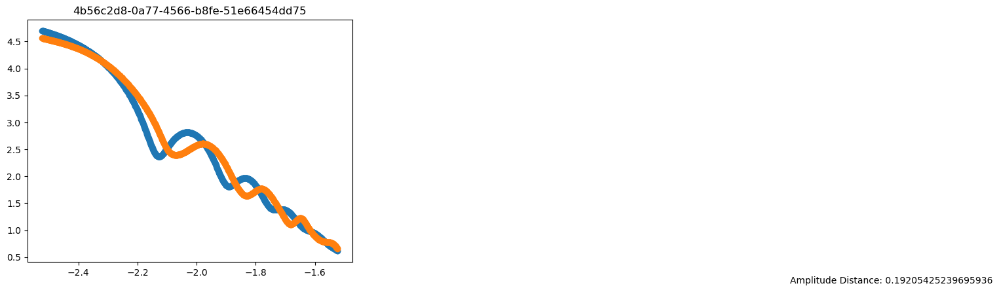

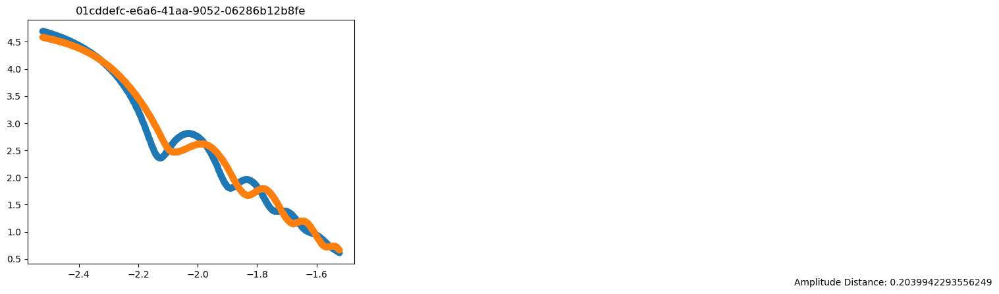

...

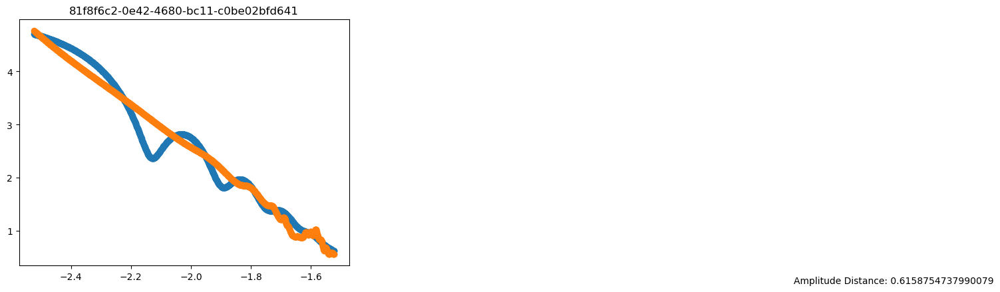

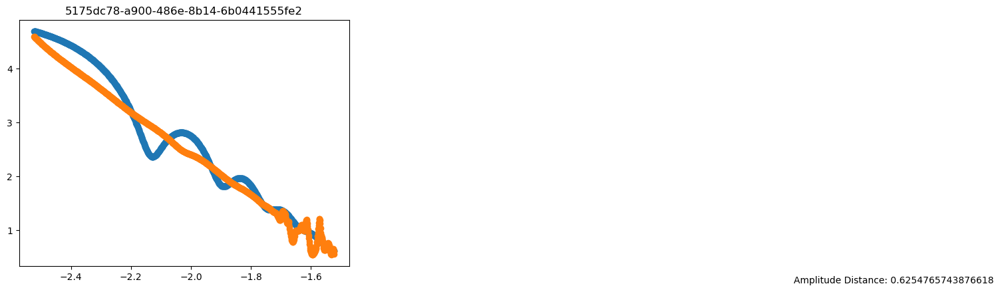

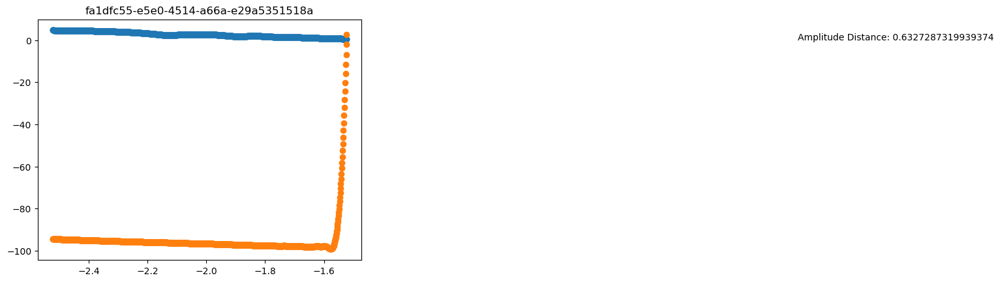

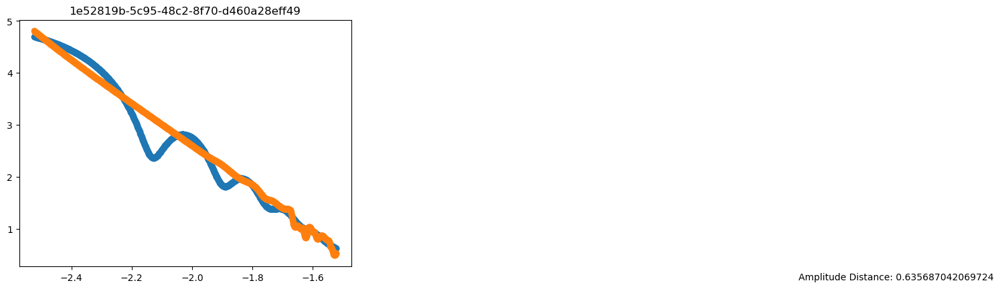

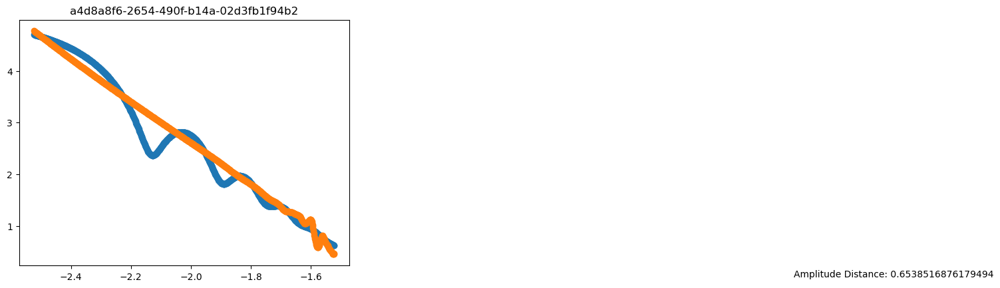

In [149]:
for uuid_val in uuid_sorted_phase:
    #try:
    entry  = dataset[uuid_val]
    data_val = entry['I_scaled']
    
    #except KeyError:
    #    print(uuid_val)
    #    continue
    if entry['status'] == 'valid':


        distance = phase_dist[uuid_val]

        fig, ax = plt.subplots()
        ax.scatter(q_grid, target_I)
        ax.scatter(q_grid, data_val)
        ax.set_title(uuid_val)
        ax.text(0.01, 0.01, f'Amplitude Distance: {distance}')

## Plot sorted results - sum of amp + phase

In [150]:
sum_ap = {}
for uuid_val, amp in amp_dist.items():
    phase = phase_dist[uuid_val]
    sum_ap[uuid_val] = amp + phase

In [151]:
uuids = np.array(list(sum_ap.keys()))
rmses = list(sum_ap.values())
uuid_sorted_sum = uuids[np.argsort(rmses)]

/tmp/ipykernel_81717/1390986055.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


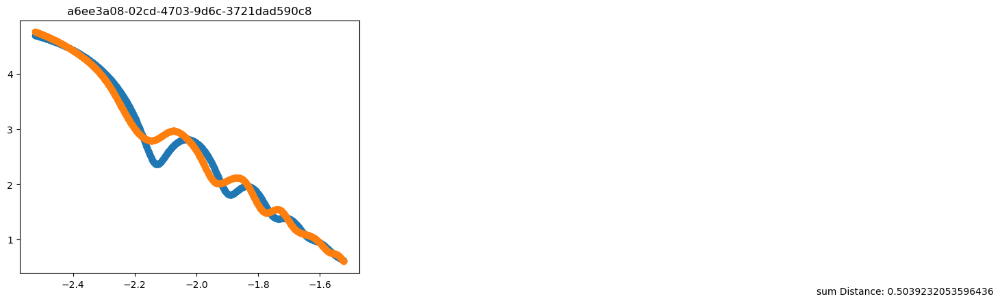

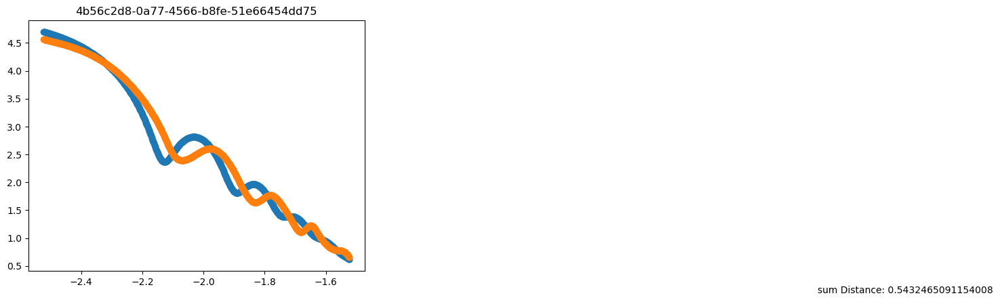

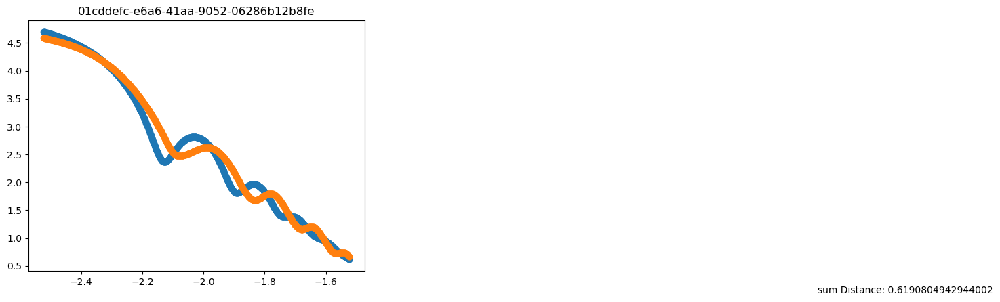

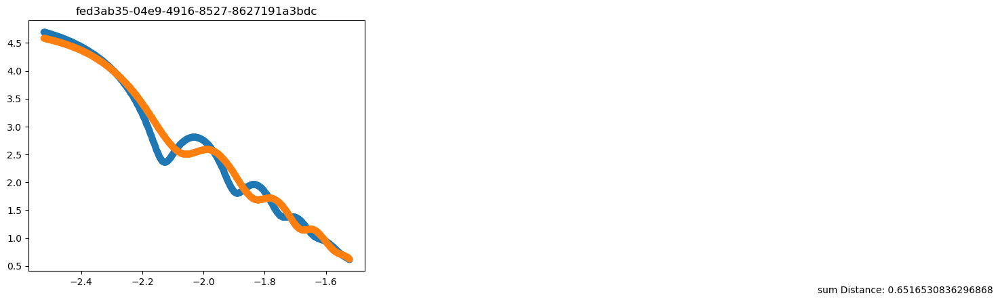

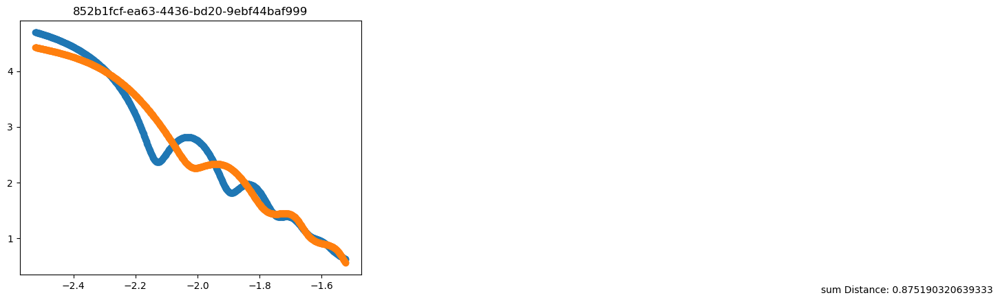

...

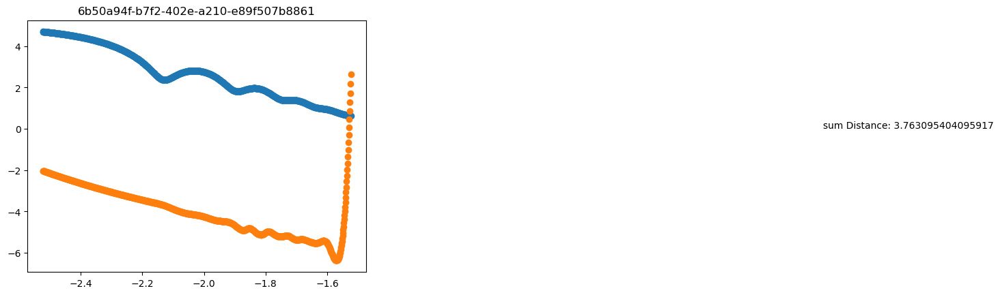

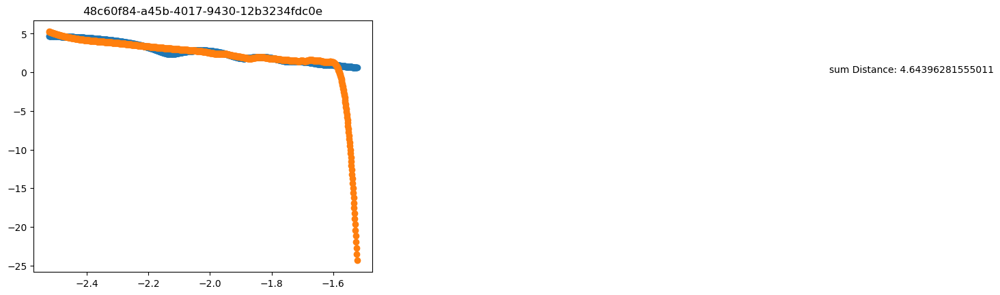

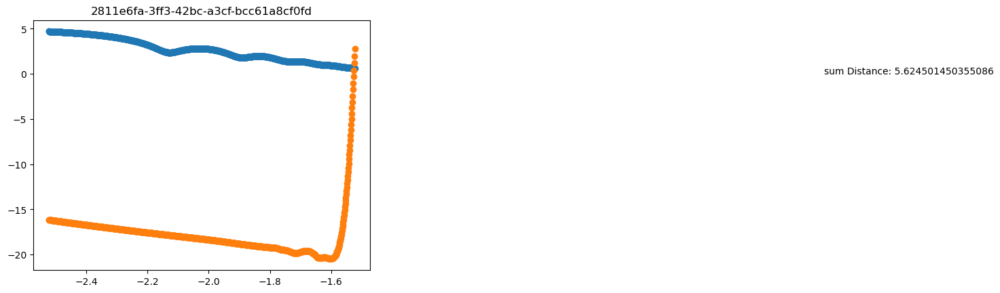

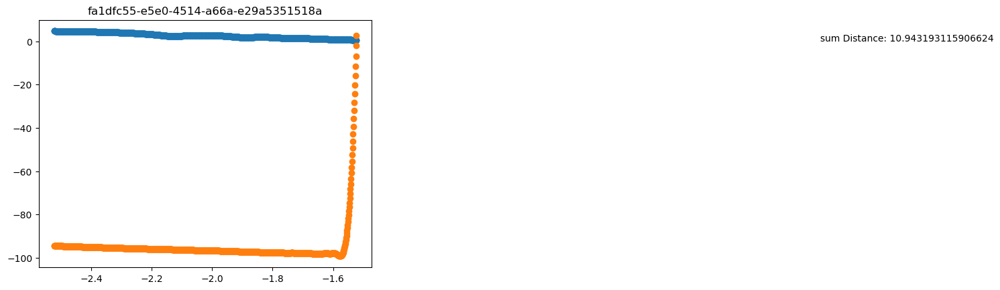

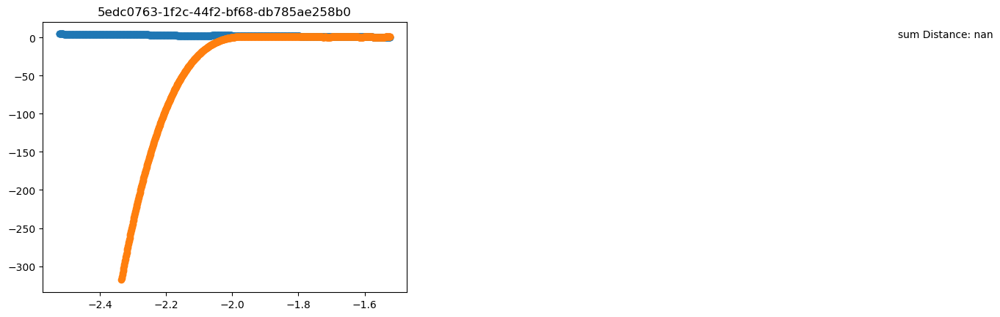

In [152]:
for uuid_val in uuid_sorted_sum:
    #try:
    entry  = dataset[uuid_val]
    data_val = entry['I_scaled']
    
    #except KeyError:
    #    print(uuid_val)
    #    continue
    if entry['status'] == 'valid':


        distance = sum_ap[uuid_val]

        fig, ax = plt.subplots()
        ax.scatter(q_grid, target_I)
        ax.scatter(q_grid, data_val)
        ax.set_title(uuid_val)
        ax.text(0.01, 0.01, f'sum Distance: {distance}')